https://youtu.be/5NgNicANyqM?si=tYR5XNw55B-n9PAi

Topics that will be covered:

- Searching
- Optimization problem
- ML
- NN
- NLTK

Knowledge and drawing inferences
Uncertainty and probability
Optimization problems
ML and NN and NLTK

---

# **Searching (uninformed and informed and adversarial)**

---

## **BFS and DFS (Uninformed)**

---

Trying to find your way in a maze. How google map makes routes.

**Agent**, any entity that preceives its env and then takes action

**State**, some config of the env
The **starting state** is the initial state
**Actions**, choices that can be taken from a certain state

**Transition model**. Takes input and action and returns new state.

**State space**, set of all the states we can get from the initial state....its shown using a graph

**Goal test**, is the given state a goal state? There can be multiple goal states.

We also have **path cost** so we can get to the best goal state from the best path.

**Optimal solution**, there can be multiple optimal solutions too.

A **node** is a data struct. It keeps track of its parent, its state, action taken to get to it, and path cost

**Frontier** has all the things that we can explore....if its empty, then there is no solution....we remove node from frontier, if its goal, we found the solution. If not, we expand the node and add all the adjacent nodes to the frontier and keep going

But what if we had some loop? Well, we could get stuck then. This is why we keep a **visited set**. We keep track of what we have explored and don't explore what is already explored.

**Stack** is our frontier, we use it in **dfs**. Stack is lifo

**Queue** is our frontier in **bfs**. It explores the shallowest node.

**Dfs always finds solution** as long as search space is finite.
Although dfs **doesn't** always find the **optimal solution**.....**bfs does**

Dfs explores a lot more states so more space complexity too.

So bfs is awesomeee.

But if the **goal state is far away**, bfs will basically be **exploring the whole graph**

**Uninformed** and **informed searches**. Basically, when we know the coordinates and every decision is informed, like a maze from a birds eye view, if you see it and uk the goal, u can easily move towards it instead of exploring needlessly. That is informed search.

Dfs and bfs are both uniformed, they don't know where exactly the goal state is and they just explore and make steps irregardless of the location of the goal state.

U can say search **strategy that uses no problem-specific knowledge is uninformed** (bfs and dfs don't care about what the maze looks like)

---

## **GBFS and A\* (informed)**

---

**Greedy best-first search** is an **informed** searching algorithm. It expands the node that is **closest to the goal state**

It uses an **estimate** of whats closest to the goal....as in **heuristics**.....cz like, if it knew exactly then there is no point in solving the problem uk

**Heuristic function** tells us how far are we from goal.
One type of heuristic function we can use is called the **Manhattan distance**......heuristics is an estimate, not a guarantee.

We need to come up with a good heuristic to make GBFS work

Will **GBFS** always find the **optimal** solution? Well, **nope**.
Its greedy, it makes the best local decision, not global.

So how do we make it optimal?
A\* search is that thing. It expands based on the **sum** of how far it is from the initial node **(g(n))** and how far it is from the goal node (**heuristics** just like in GBFS)

A\* is optimal if heuristic is **admissible** (either its exact or it underestimates the value, never overestimates)

And the heuristic function must also be **consistent**
(for every node n, the successor node n' and the step cost **c = h(n) <= h(n') + c**)

Choosing the heuristics is the real challenge......A\* is knows to have a high space complexity btw

---

## **Minimax and $\alpha-\beta$ pruning (adversarial)**

---

What if its a search problem that is an **adversarial scenario**......there is another agent and it wants you to fail.......like tic tac toe, 2 players

These are adversarial search algorithms

We use **minimax** search here

**Minimax algorithm**

Mostly, there are **3 possible outcomes**.....p1 wins or p2 wins or draw

So -1 if **opponent wins**. 0 if **draw**. 1 if p1 (us, or agent1 lets say) **we wins**

**Max player** (p1) tries to maximize the score (it wins at 1, draws at 0, loses at -1)

**Min player** will do the exact opposite and try to minimize the score

Thats why its called minimax algo

We will need an **initial state**.
A way to tell **whose turn it is**.
We need **actions** and **transition model** as well.
B4 we had **goal state**, now we have **terminal state**. **Checkmate basically**.
And we need **utility function**, which assigns value to all the possible results.

Minimax is **recursive**. Consider all the moves your opponent can make, it considers all the future moves.

**minimax** works for most games where you take a turn, then the other person takes a turn, and so on.
given a state s:
max player picks action a in **actions(S)** that produces **highest value** of **min-value(result(s, a))**....the min player would do the opposite

first, check if the state is a terminal state, **if it is terminal**, just use the **utility function** to **check who won**
what if the state is not terminal? well, now you have to do the **recursive thinking** and think about what your opponent is going to do on his next move.
we will use a **variable called v** to store the **value (which max player will maximize eventually)** and initially set **v = -inf** (we will try to do better each time)
now, lets consider the action:

```python
for action in ACTIONS(state):
v = MAX(v, min-value(result(state, action)))
return v
```

so we are basically **checking what is the best that the min player is trying to do**. so we go through all the possible actions, given what my opponent is ganna try to do
this logic will be completely flipped for the min player

max player be like: "alright, min player is going to try to minimize my score,**so which of those min possibilities will give me the highest score?**?"

so this is going to be a long process, if the game has lots of moves/actions and so on, **then the possibilities might be like....a lotttt**
sooooooooo, how can we **optimize** dawg??

we can **stop** the **calculation** as soon as we **see a smaller value** **then our already achieved value** (assuming that our opponent, the min player will play optimally). so lets say we are playing a game where we have **3 actions from each state** and then we see what move we should make (by checking what move the min player would make in each of the 3 scenarios) if we get 4 as the value on first state and then we get 1 as the first value on the second state calculation, we can stop the second state calculations there and say that the first state would yield a much better result since if the min players plays optimally there, it would get a 4, but if it played optimally on the second state, we would get a 1. hence the first state would be a lot better for us, the max player that is. its like a 'stop, no need to calculate more, we found the best already'

that **optimization approach is called alpha-beta pruning**. alpha and beta are the two values we track , the best we can do and the worst we can do.

there are about 255,168 possible tic tac toe games

what about chess? well after 4 moves from each player, there are 288 billion possibles
and total of all chess games is 10^29000

now, for **further optimization**, we use **depth-limited minimax algorithm**

this is **just like DLS** where you set a limit to the depth.
but what if after that specific depth, the game is not over? well, we need to add an **evaluation function** which estimates the expected utility of the game from the given state

the evaluation function is basically telling us **how good the state is for the agent**.
so the evaluation function needs to be hella gooddd. in chess, you can have some evaluation function like how many pieces do you have VS your opponent

whenever an AI is faced with making decisions, that is when we need our AI to be hella smart and so on, it must be able to smartly make decisions basically

<br>
<br>
<br>

<hr style="height:8px; background-color:	#00FFFF; border:none; margin-top:30px; margin-bottom:30px;">

<br>
<br>
<br>


---

# **knowledge based agents**

---

## **Propositional Logic**

---

**knowledge based agent**, they operate on **internal representation of knowledge**
**reasoning based on knowledge** (there would be some knowledge base, we would use that info to infer conclusions)
so we basically are **making inferences**, like, they should be able to do deduction and stuff, be logical

**sentence**: an assertion about the world in a knowledge representation language
we will be using **propositional knowledge**, it is based on propositions
we will have **symbols** like P and Q and R. each of these 3 represent some kind of sentence or some sort of fact about the world
but we also need to be able to **combine these symbols** and pieces of info, we use **logical operators** for that like **not, and, or, implication, biconditional**

we will have **truth tables** for each logical symbol of course. the implication operation is a single head arrow and biconditional operator has a two headed arrow

### **Truth Tables**

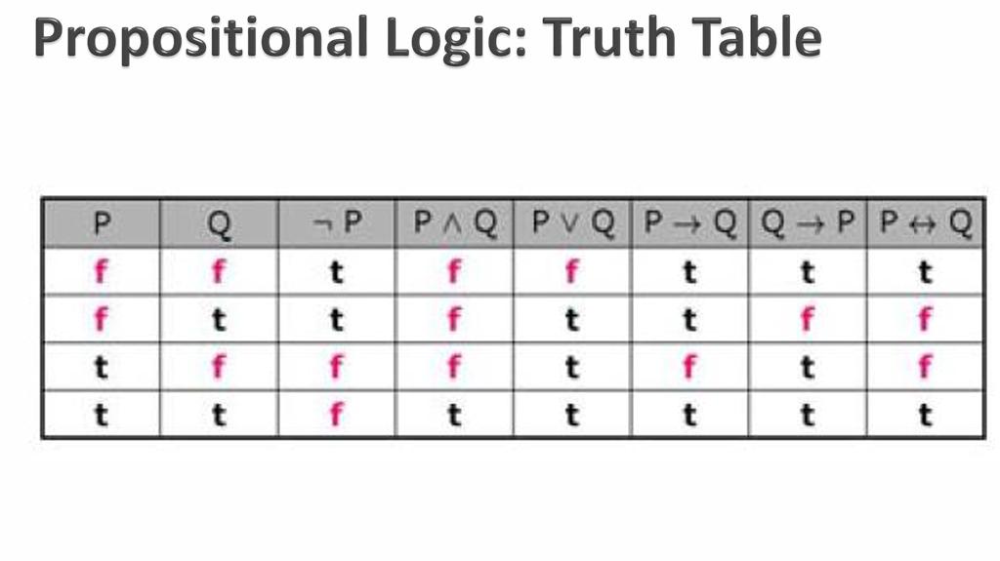

implication means: if its x then it will be y.
biconditional is an if and only if basically

**model:** assigns a truth value to every propositional symbol, it is kinda creating a possible world, an environment

**knowledge base:** a set of sentences that our agent knows to be true

**entailment** ( **|=** ): in every possible world, if x is true, then y is true too. so if we say that alpha entails beta, then that means that in every single environment, if alpha is true, beta will also be true

**inference:** process of deriving new sentences from old ones.
our inference algorithm is basically trying to answer: **does our knowledge base entail x, where x is some sentence**

one algorithm for this is **model checking**: **its a simple brute force algorithm**:
we enumerate all possible models, which basically means to consider all true/false values of all variables. if in every model in which our KB (knowledge base) is true, the sentence x is also true, then our KB does entail x

**knowledge Engineering** is basically converting real world knowledge into knowledge that we can give to a computer
model checking is an inference algorithm btw.
you can create a model checking model for the game 'clue'. An example is in the video

we can also solve logic puzzles using this.

we add the info/knowledge, and the model makes inferences.

Another game covered in the course is called mastermind, model checking model can also be used on that.

but, as always, we gotta optimize.
Model checking has O(2^n) possibilities basically, where n is the number of variables

so, how do we optimize?
well, we use inference rules.
we structure an IR with a horizontal line, the thing above it is the premise, something you know to be true, and the thing below the horizontal line is the conclusion, the thing we can get to using logic.

inference rules are known as Modus Ponens btw, and we normally use representation like:
alpha --> beta then alpha/beta
so if alpha implies beta, and we also know that alpha is true, then we should be able to conclude that beta is also true.
so model checking was like, consider all the world and see whats true in which world. this is totally different as compared to model checking, we just check the knowledge we know, and we see what conclusions can we make using that knowledge.

eg:
### **AND Elimination**
harry is friends with Ron and Hermione / harry is friends with hermione.
think of the / as the horizontal line btw.
this above method is called AND Elimination, as in, if alpha and beta are true then that also means only alpha is true and only beta is true. if both parts are true, one part is also true.

eg2:
### **Negation Elimination**
it is not true that harry did not pass the test / harry passed the test
this is called Double Negation Elimination. this is basically 2 NOTs cancelling each other out
~(~a) / a

eg3:
### **Implication Elimination**
if it is raining then harry is inside / it is not raining or harry is inside
this is known as Implication Elimination, the logic here is basically: harry if outside, then its not raining (the first part of the conclusion). and the second part of the conclusion is gained simply, as in, if its raining then harry is inside.
so, you can basically flip the sentence to find the second part of the conclusion.
if its raining, harry is inside
if harry is outside, it is not raining

simply:
alpha --> beta / ~alpha OR beta

eg4:
### **Biconditional Elimination** 
it is raining if and only if harry is inside / if its raining, then harry is inside. And if harry is inside, then its raining

this iss called Biconditional Elimination.

alpha <--> beta / (alpha --> beta) AND (beta --> alpha)


eg5:
### **de morgan's law (AND to OR conversion)**
it is not true that both harry and ron passed the test / harry passed the test OR ron passed the test (or both since its an OR btw)

this is de morgan's law, we can basically turn ANDs into ORs using this law.

~(alpha AND beta) / ~alpha OR ~beta

eg5:
### **de morgan's law (OR to AND conversion)** 
it is not true harry or ron passed the test / both harry and ron did not pass the test

this was again the de morgans law but we are converting OR to AND this time.

eg6:
### **Distributive law**
(alpha AND (beta OR gamma)) / ((alpha AND beta) OR (alpha AND gamma))

this is obv the distributive law. and of course the opposite can be done too.

theorem proving can be done using a knowledge based agent. the initial state would be the starting knowledge base, the actions would be the inference rules, the transition model would be the new knowledge gained after inferences, the goal test would be to check statement that we are trying to prove, and the path cost function would be the number of steps in the proof (you can think of this as knowledge engineering kinda)


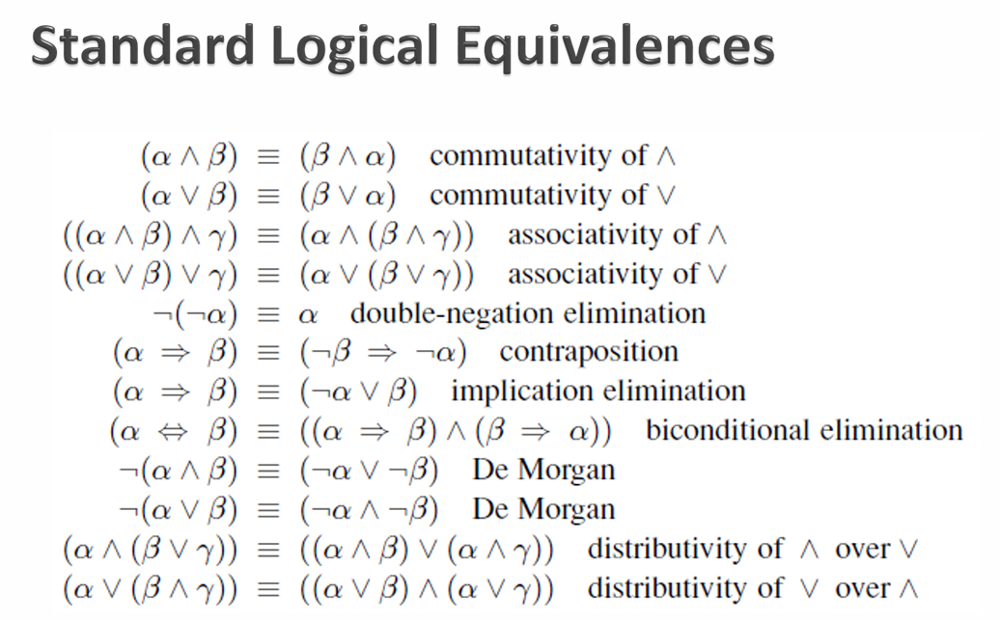


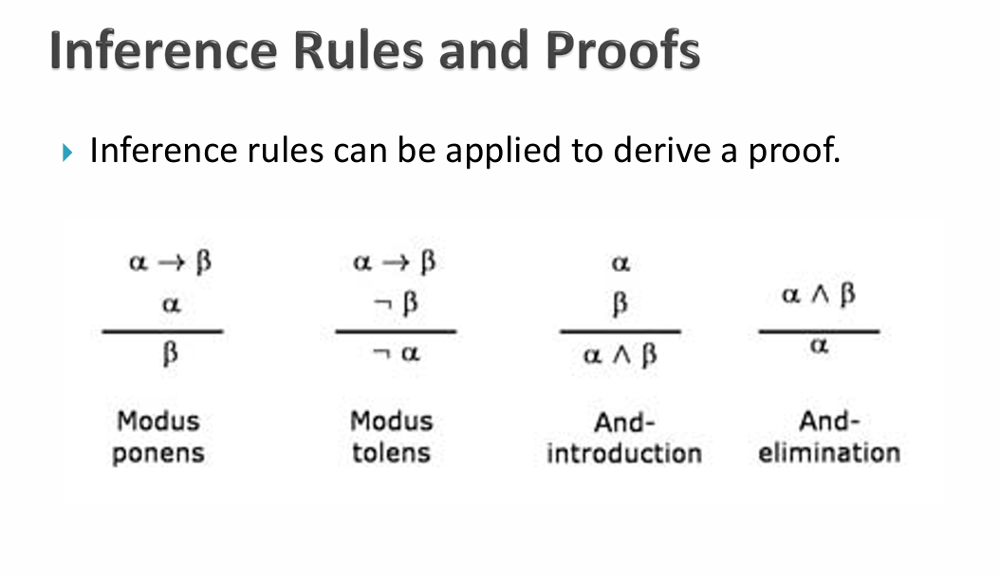




---

## **Resolution**

---

there is another way to apply inference called **RESOLUTION**:

ron is in the great hall OR hermione is in the library (lets say thats in our knowlegde base)

and then we say: ron is not in the great hall / hermione must be in the library (since the above mentioned OR is true)

ron is in the great hall in the knowledge base and ron is not in the great hall in that inference, these 2 statements are called complimentary literals.

this is the Unit Resolution rule:

P OR Q
and we also know that ~P
then the value below the horizontal line must be Q

this is a very powerful rule.

say:

- ron is in the great hall OR hermione is in the library (lets say thats in our knowlegde base)
- (ron is not in the great hall) OR (harry is sleeping)
- these are 2 clauses, and we can easily conclude based on those that:
  - (hermione is in the library) OR (harry is sleeping)

generally:

P OR Q
~P OR R
conclude: Q OR R

### **Disjunction and Conjunction**

a clause is a disjunction of literals (disjuntions is just statements connected with ORs. conjunctions are statements connected with AND)

literals are propositional symbols (p) or their opposite (~p)

this gives us the ability to turn logic, any logical sentence, into a conjunctive normal form, which is a logical sentence that is a conjunction of clauses.
so ANDS or disjunctions (since a clause is disjunction).

### **Conjunctive Normal Form**
we can take any sentence in logic and convert it to conjunctive normal form (CNF)

steps for CNF:

- eliminate the bi-conditionals (a <--> b into (a-->b) AND (b-->a))
- eliminates the implications (a --> b into ~a OR b)
- move the ~ inwards using de morgan's law (~(aANDb) into ~a OR ~b)
- lastly, use distributive law to make the ORs end-up on the inside of the expression and the ANDs end-up on the outside of the expression

(pORq) --> r
~(pORq) OR r (remove implication)
(~pAND~q) OR r (move ~ inwards using de morgans law)
(~pORr) AND (~qORr) (distributive law to move ORs inside expression and ANDs outside expression)

once the sentences are in this form, we can give this as input to the resolution rule. this will be **inference by resolution**

### **Factoring**

we also do factoring during the resolution process where we eliminate duplicates:

p OR q OR s
~p OR r OR s
conclude: q OR s OR r OR s
now that s is repeated twice and its redundant, so we simplify to:
q OR r OR s

### **Contradiction**

what if you try to resolve the following:
p
~p
conclude: empty clause (which is equivalent to just false, as in a contradiction)

resolving 2 contradictory clauses leads to an empty, false set (that is what happened above)


- to determine that our knowledge base entails a (kb |= a)
  - check if (kb AND ~a) is a contradiction
  - we are trying to prove by contradiction, like, if you want to prove that something is true, you do so by assuming that it is false first, and then showing that it leads to a contradiction...if it does lead to a contradiction, then that thing that you assumed is false, must be true
  - keep checking to see if we can use resolution to produce a new clause.
  - if ever we produce the empty clause (resolving p and ~p). we have a contradiction, and kb |= a.
  - otherwise, if we can't add new clauses, then no entailment

eg:

- does (A OR B) AND (~B OR C) AND (~C) entail A?
- assume ~A
  - (A OR B) AND (~B OR C) AND (~C) AND (~A)
  - the above is in conjunctive normal form.
  - now look for 2 clauses that can be resolved
  - (~B OR C) AND (~C) (we can resolve this since the opposites exist here, as in C and ~C)
  - so using these 2 clauses, we can get a new piece of info: (~B)
  - now we have: (A OR B) AND (~B OR C) AND (~C) AND (~A) AND **(~B)**
  - now again, we have (A OR B) AND (~A) where again, we can resolve
  - (A OR B) AND (~B OR C) AND (~C) AND (~A) AND (~B) AND **(A)**
  - well, now we have (~A) AND (A), which, of course, leads to the empty set, as in a contradiction, and hence, we can say:
  - our KB DOES entail A

all of this so far was based on propositional logic, but, issue is that propositional logic does have limitations, like it needing a lot of symbols etc.




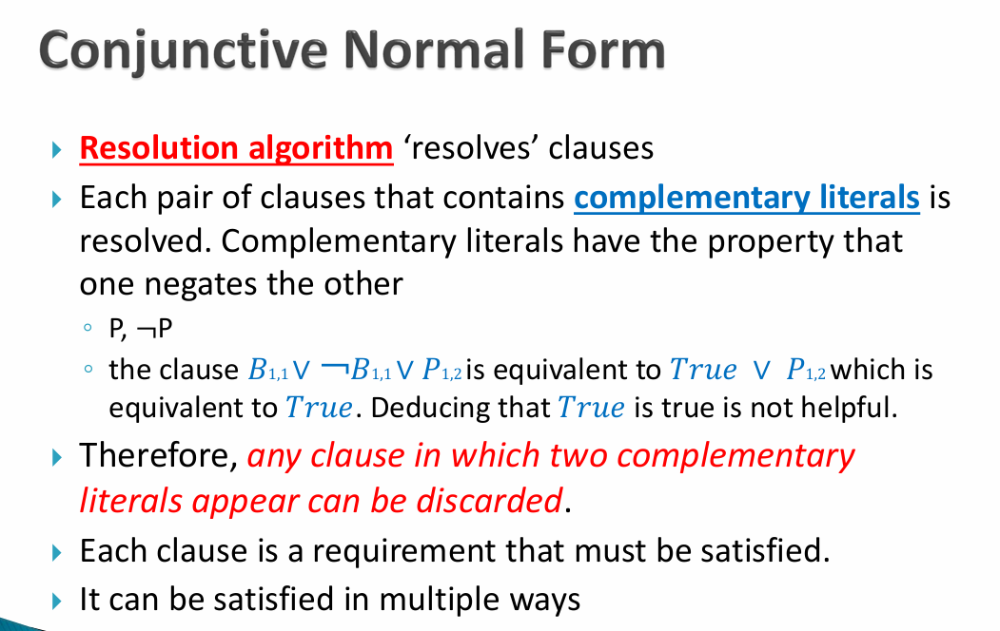




---

## **First-Order Logic**

---

another type of logic is: **First-Order Logic**

this logic gives us 2 different types of symbols:

1. constant symbols
2. predicate symbols (properties that might hold true or false for some constant)

eg:
sentence is first order logic:

- person(minerva) --> minerva is a person (that --> is not implies here)
- house(gryffindor) --> gryfindor is a house
- ~house(minerva) --> minerva is not a house
- belongsTo(minerva, gryffindor) --> minerva belongs to gryfinndor
- so basically, the number of symbols will decrease a lot

first order logic has additional features too, as in, Quantifiers:

one type is universal Quantification: upside-down A
its the simple "for all" symbol

![Screenshot 2025-03-31 141612.png](<attachment:Screenshot 2025-03-31 141612.png>)

we also have existential quantification: it means 'for some' instead of 'for all'.
the backwards E means exists

![Screenshot 2025-03-31 141717.png](<attachment:Screenshot 2025-03-31 141717.png>)

eg:

![Screenshot 2025-03-31 141828.png](<attachment:Screenshot 2025-03-31 141828.png>)

there is also second order logic and so on, to represent more complex ideas. all this is about representing information and knowledge. we want our agent to be able to represent information and also be able to draw conclusions from it.

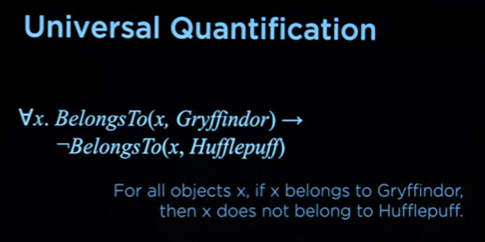
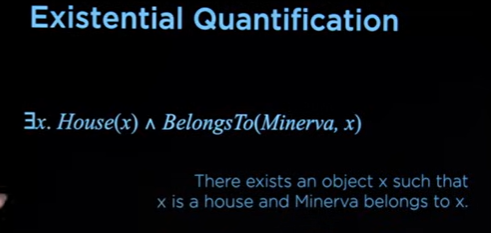
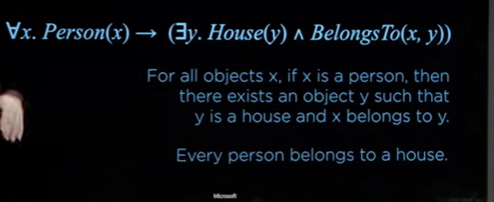


<br>
<br>
<br>

<hr style="height:8px; background-color:	#00FFFF; border:none; margin-top:30px; margin-bottom:30px;">



<br>
<br>
<br>


---

# **Uncertainty**

---

## **Probability**

---

### **Unconditional Probability**

---

we need to first understand probability if we want to tackle uncertainty.

probability just means that 'there are possible worlds', like when you roll a dice, there are 6 worlds.

P(omega) means probability of omega (where omega is one possible world)

0 <= P(omega) <= 1

where 0 is impossible and 1 is 100% probability

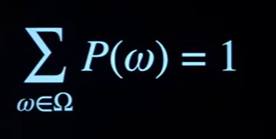

that above notation means: for a world (omega) that exist in big-omega (all the worlds), the sum of probability of all them should be 1

if you have 2 dies, you would consider the possibilities as follows:

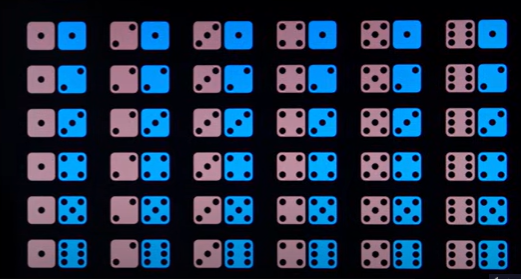

if we want to find the probability of the sum of the 2 dies being 12: it would be 1/36.
but if we want to find probability of the sum being 7: it would be 6/36=1/6

these are unconditional probabilities: degree of belief in a proposition in the absence of any other evidence.


---

### **Conditional Probability**

---

conditional probability: degree of belief in a proposition, given some evidence that has already been revealed.

P(a | b), we read this as 'what is the probability of a if b is true'

eg:
P(rain today | it did rain yesterday)

P(disease | tests)

how do we calculate conditional probability:

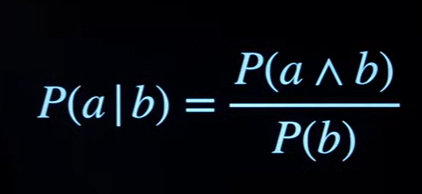

read this as 'if i want to know the probability that a is true if b is true then i will consider all the ways they both can be true while ignoring the ways where b isn't true'

eg:

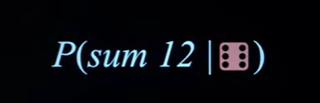

you know that the red die is for sure = 6, so now you can ignore all the rest of the worlds and only consider the worlds where the known evidence (b, or red die in this case) is true

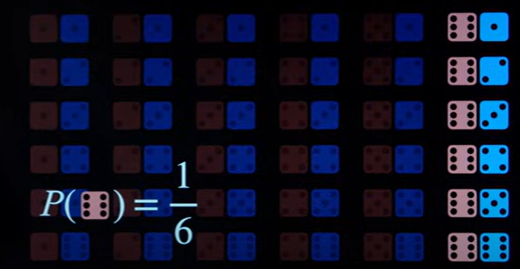

that was the denominator calculation, now what about the numerator, what is the possibility P(sum 12 AND red die is 6), well, the sum is equal to 12 and red die is 6 in only one world so it would be 1/36.

so the numerator would be 1/36 while denominator would be 1/6 and that would resolve to:
1/6

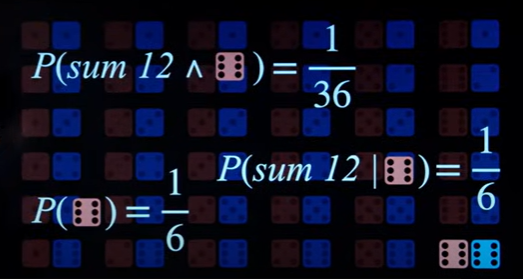

there are many ways to write this conditional probability formula btw:

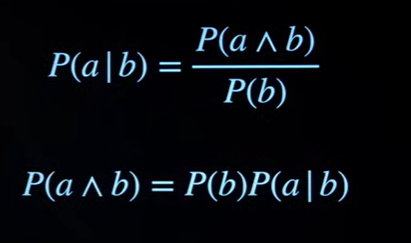

now this was more about a yes or no answer where we were trying to say that this even happened or not and so on, we also have variables in probability, these variables are called random variables:
a variable in probability theory with a domain of possible values it can take on. it can take on a domain of values basically

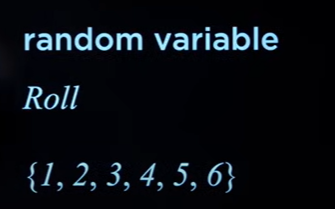

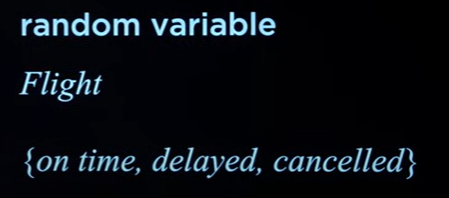

a Probability distribution will give us the probability of each value in that domain, and the sum of all the probabilities the distribution would be equal to 1

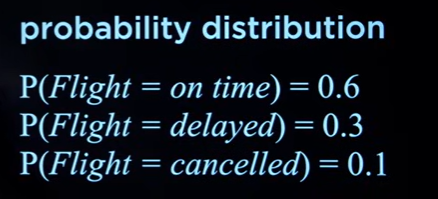

we can represent these in vectors:

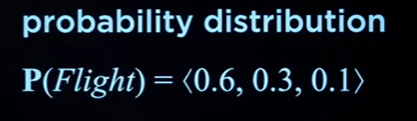

another important concept in probability is Independence:
the knowledge that one even occurs does not affect the probability of the other event.

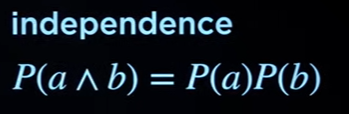

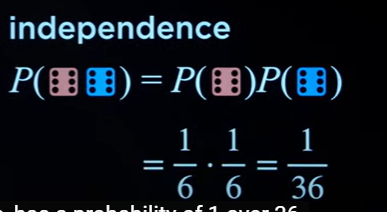

but what would dependence look like:

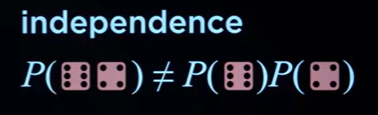

now, in the above case, if you know that the red die is a 6, then you know that red die cannot be 4 as well. so these 2 events are dependent, as in, if the red die rolled a 6, then the probability of the red die rolling a 4 would be 0, since it has already rolled a 6.

we won't just sum probabilities in the dependent case, we will use our formula since it does account for dependency:

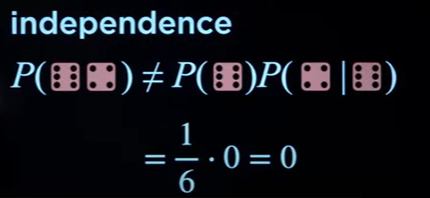

**BAYES' RULE**

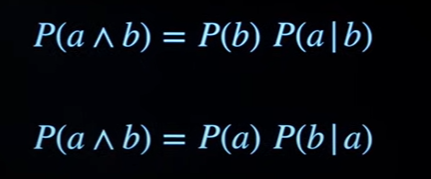

we know that the above are both true. we can use them to derive bayes' theorem

we can set them equal to each other:

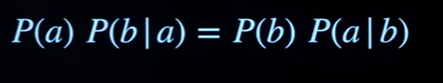

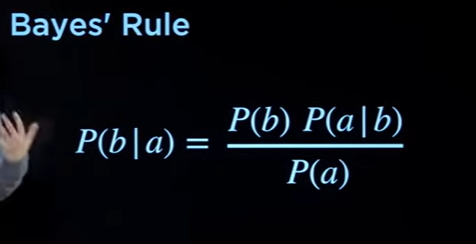

that is bayes' rule

you can switch the order btw since its just multiplication:

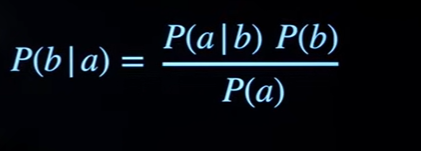

bayes' rule is super fricking important.

eg:

consider 2 possible event:

cloudy in the morning

rainy in the afternoon

what i want is: given clouds in the morning, what is the probability of rain in the afternoon

lets say we know that:

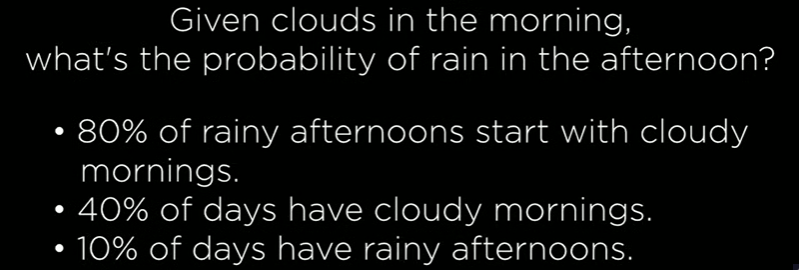

so we can plug the values into bayes' theorem and get:

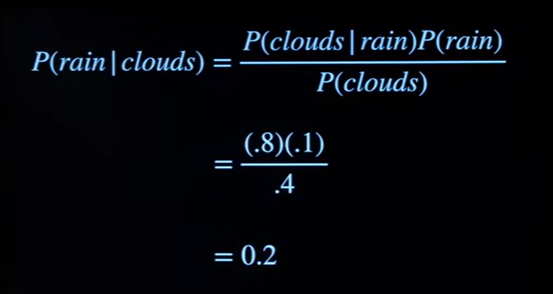

this theorem is very useful when knowing the reverse of what we want is easier.

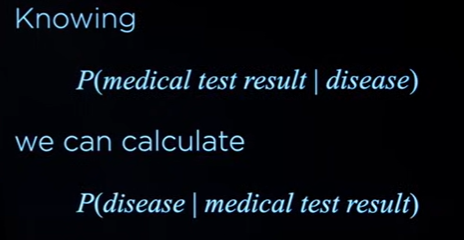

given one conditional property, you can calculate the other conditional property.

another type of probability is Joint probability, as in considering the probability of multiple events at the same time.

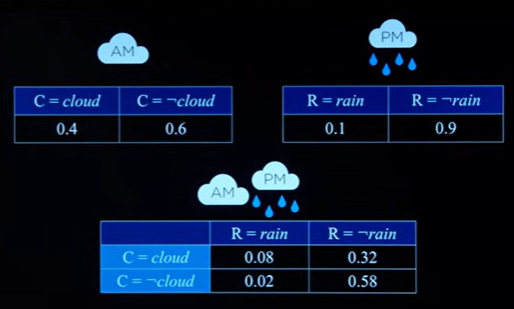

having a joint probability distribution, we can use conditional probability in it to get more info:

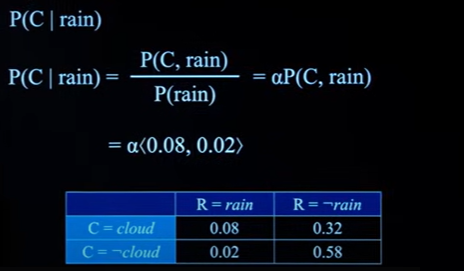

the P(rain) in the denominator can be considered a constant of sorts so we just multiple the value alpha to the numerator. alpha would be representing the affect of the denominator constant.

once we have that 0.08 and 0.02, and we know that adding that up is not equal to 1, we can plug in an appropriate value for alpha to 'normalize' our equation and get our 1

in this case, alpha would be 10 btw.

there are other imp probability rules too:

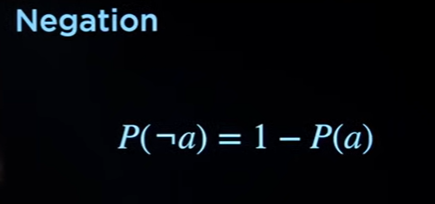

you gotta exclude the cases where both cases are true to prevent over-counting:

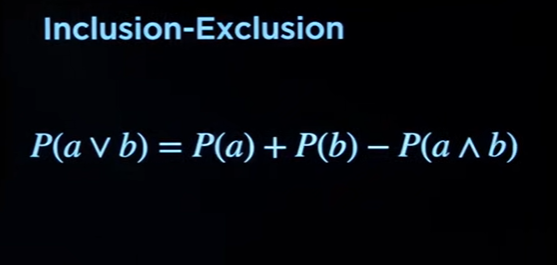

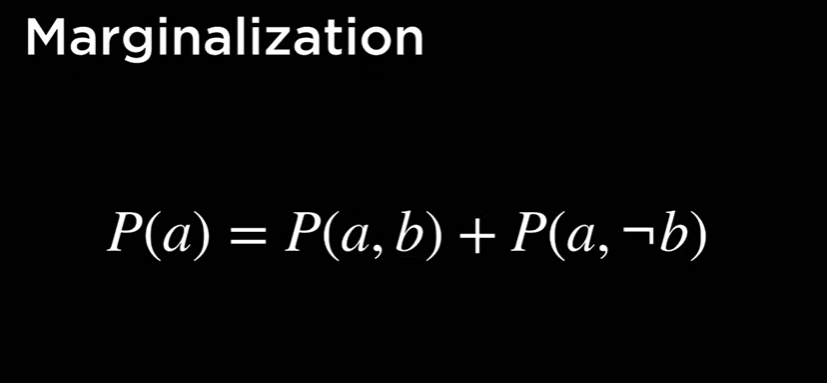

marginalization could also be with random variables:

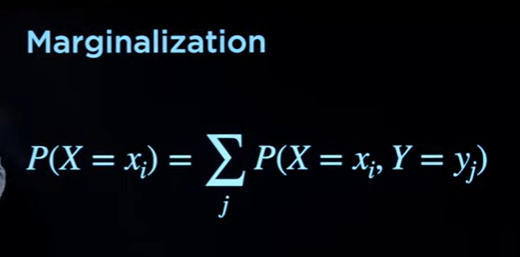

eg:

unconditional probability that it is cloudy, using marginalization:

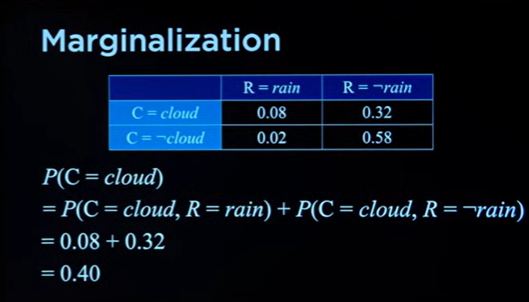

one more rule is:

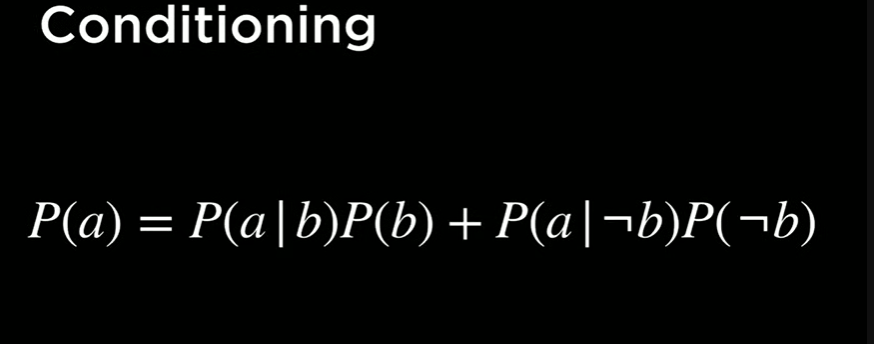

conditioning is the equivalent of marginalization in conditional probability.
marginalization is used in unconditional while conditioning is used in conditional probability

there are many different probability models. one of them is:

Bayesian Model: data structure that represents the dependencies among random variables

it assumes that most random variables in the world are dependent on each other in some way.

a bayesian network is a directed graph, each node represents a random variable, an arrow from node x to y, which means that x is a parent of y. each node will have a probability distribution associated with it.

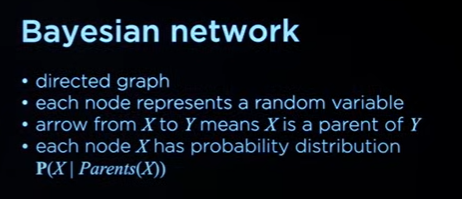

eg:

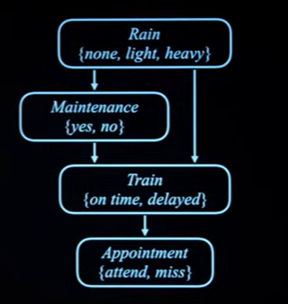

the arrows from one node to another show the concept of dependence basically.

1. the probability of the root node will be unconditional

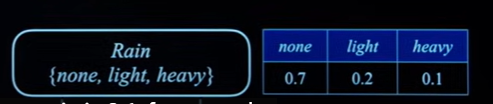

2. lets consider the next node now, maintenance: we will say the heavier the rain is, the less likely maintenance is, this is a conditional probability variable

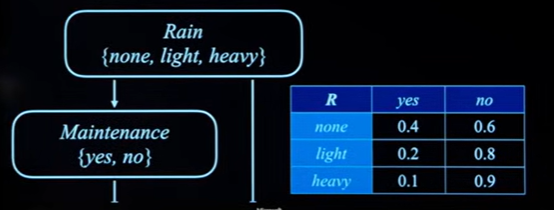

3. now lets consider the next variable: train being on time or being delayed. it is dependent on both the rain and maintenance:

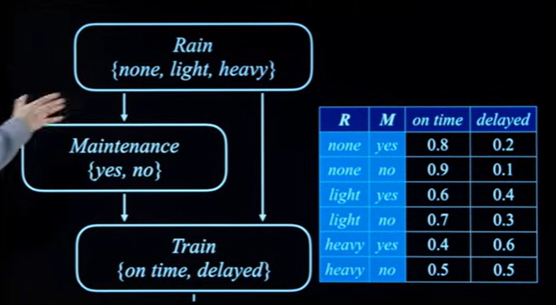

4. lets consider the next variable in the network: me attending or missing the appointment: this is dependent on the train.

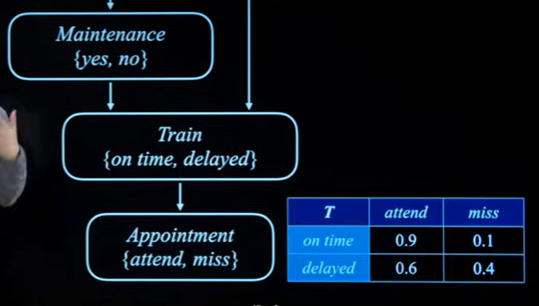

5. the real thing is logically creating the bayesian network and making the correct relationships.

probability of no maintenance given that there is light rain:

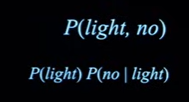

probability of delayed train and maintenance and light rain

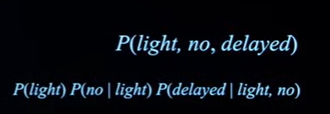

probability of light rain and no maintenance and delayed train and missing the appointment

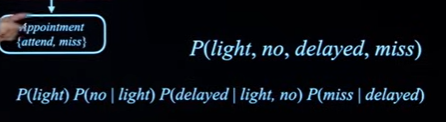

in the context of knowledge, we talked about inference. now we will discuss the same thing but in probability.
So, inference in a probabilistic setting

inference would be:

- a query, which is a variable for which to compute the distribution.
- evidences, which are observed variables for the event
- hidden variables, these are non query and non evidence variables.

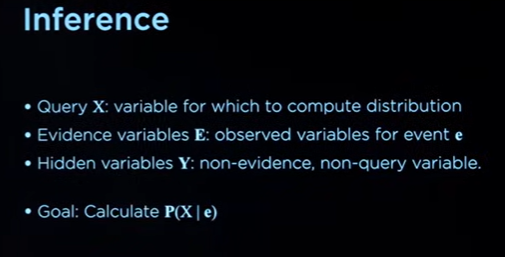

remember: conditional probability is proportional to joint probability.

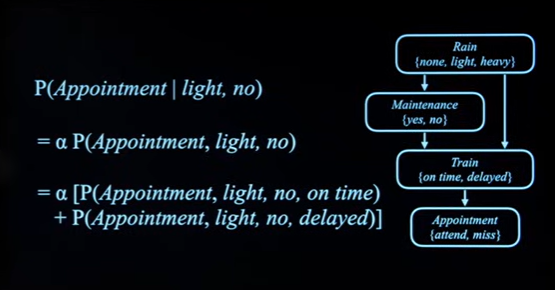

the third step is marginalization.

this is inference by enumeration:

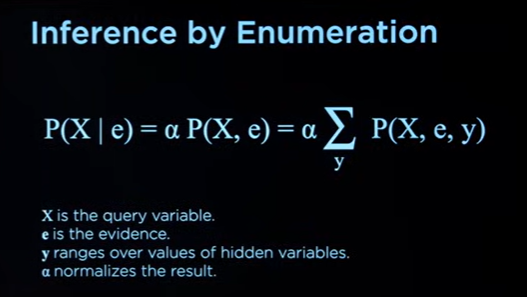

we can use libraries in python for these bayesian networks etc, one library is **pomegranate**

now, inference by enumeration is pretty un-optimized, so we gotta optimize it:

lets approx the inference instead of calculating the exact inference:

this concept is called approx inference, and you do this through sampling:

you can do this sampling many many times and then make your conclusion

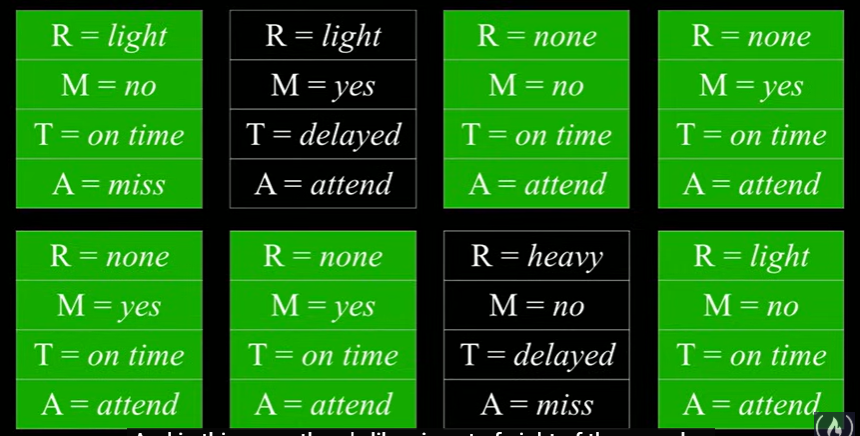

we can also do sampling on conditional probability too, you would just need to ignore the worlds where the condition is not met.

one issue with rejection sampling is that if you are trying to find an unlikely event, then you will be rejecting a lot of samples.

one other sampling method is **likelihood weighting**

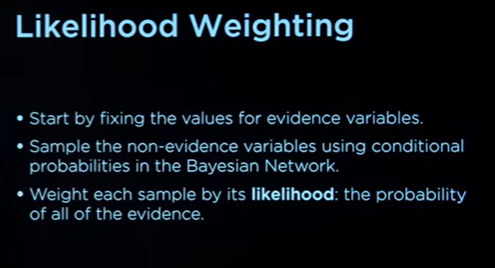

we can also have uncertainty overtime, where you would need to consider the random variable for each timestamp.
now, this is a whole lot of data, so we make some simplifying assumptions:

we will make the Markov assumption:

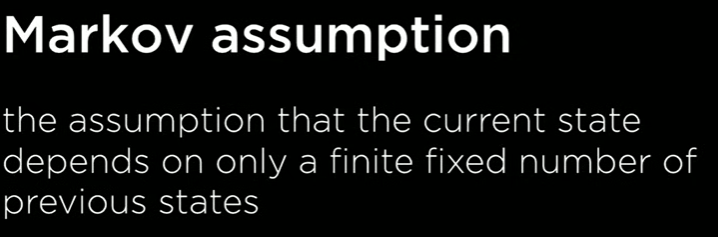

we can create a markov chain using the markov assumption:

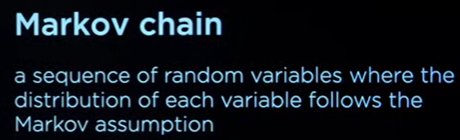

you can represent this using a matrix: this is our transition model

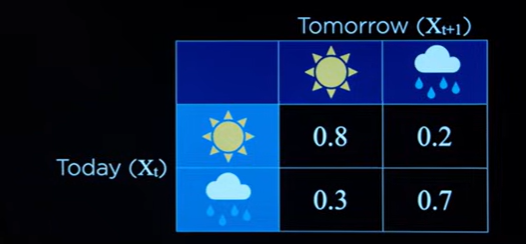

the pomegranate library in python has functionality for this too

we can also use hidden markov models:

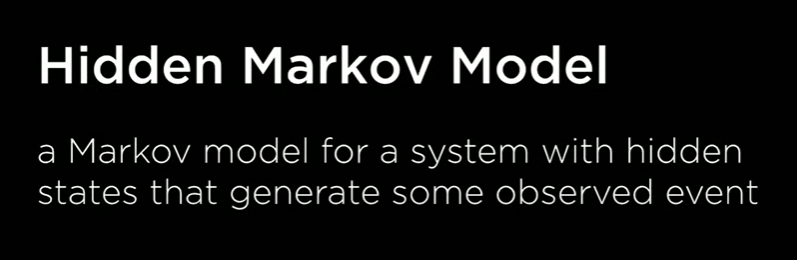

the transition model for the hidden model would be:

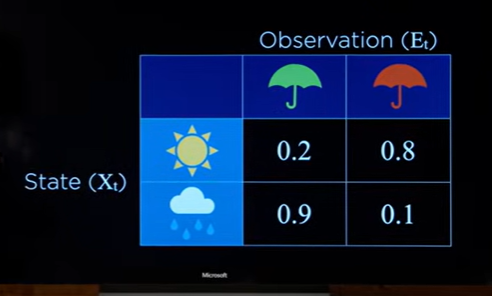

this is also called the sensor model

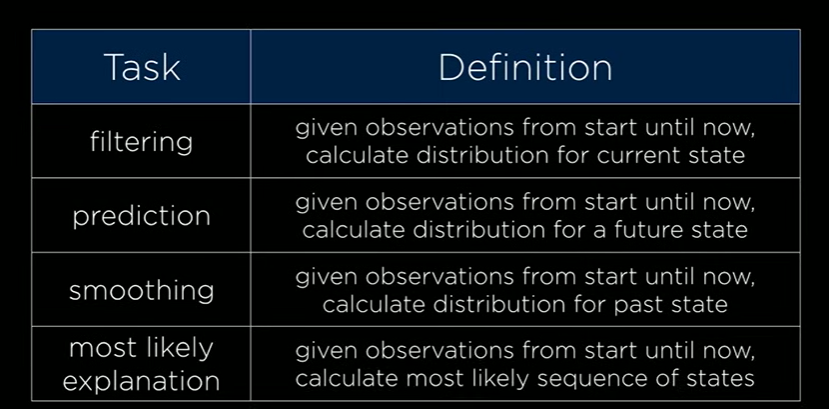




<br>
<br>
<br>

<hr style="height:8px; background-color:	#00FFFF; border:none; margin-top:30px; margin-bottom:30px;">

<br>
<br>
<br>


## **Probability Revision**

https://youtu.be/7D_4cXnj2Z0?si=KzekVe9ictz0dBIh

This is a super core concept in AI and ML, AI is never perfect, it all works on probability. if you haven't studied probability, you aren't ganna be good at AI ever.


we will cover simple formulas and proofs

### sum of events = 1
- P(a) = 0.5 then P(~a) = 1 - 0.5
### Conditional probability
- P(a | b) (probability of a given b)
- Prior Probability (the probability of b in the whole "probability of a given b" is the prior probability)
- 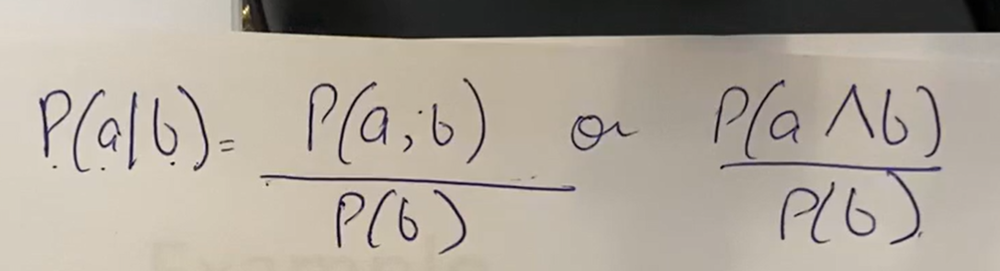
- the $\land$ sign and the comma are interchangeable, they just mean intersection
- 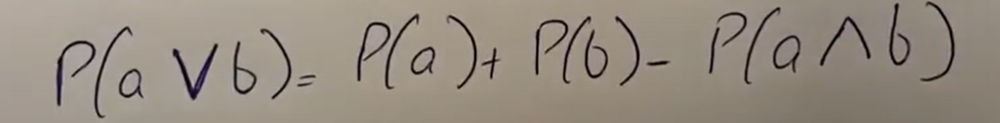
- Rule of independence (a and b are independent, they got nothing common):
  - 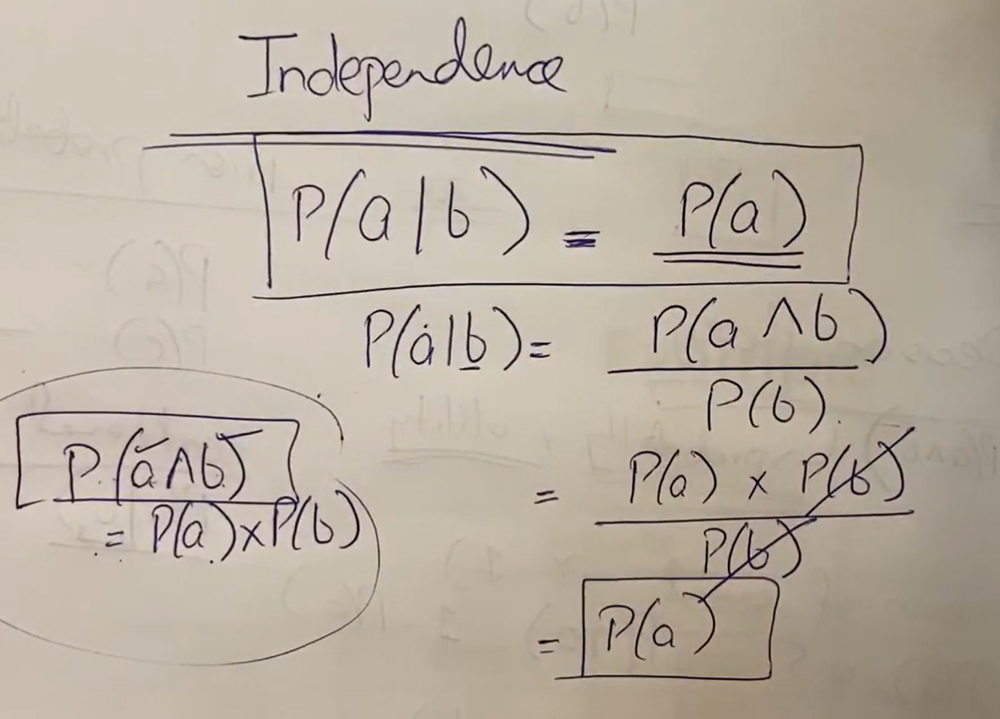
- the following table is a joint probability distribution
  - 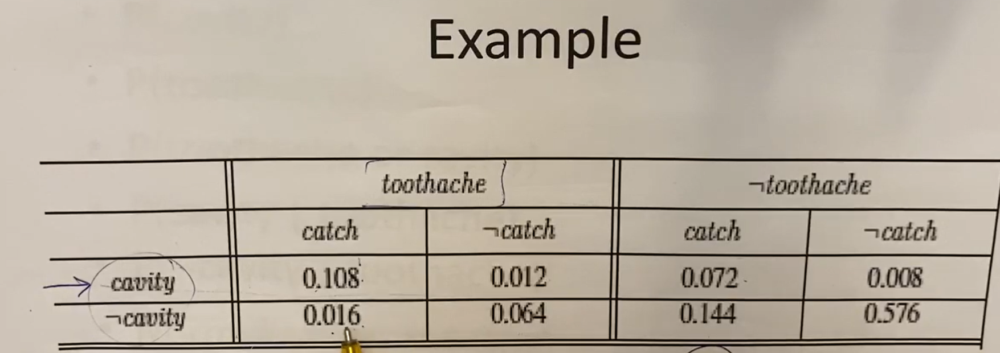

- given the same evidence, we can just subtract from 1 to get the other, like, if we know a given b and we gotta find ~a given b (same evidence) then just subtract P(a) from 1 and you got it
- 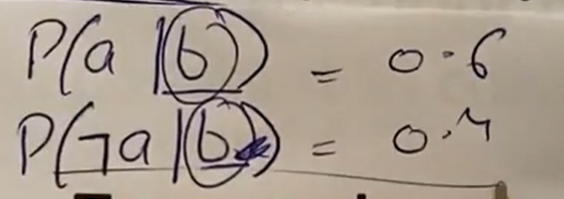
- 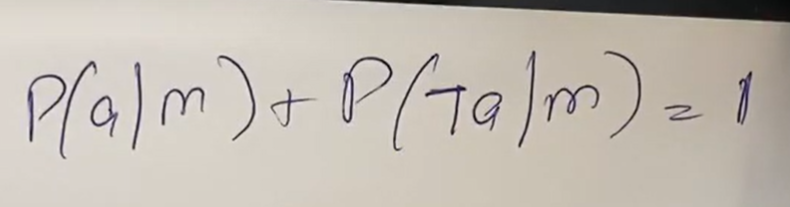

- the sum of the whole thing would be the Probability of fever (in the image below), like, the probability of the first whole row is equal to the probability of f (f = fever)
- 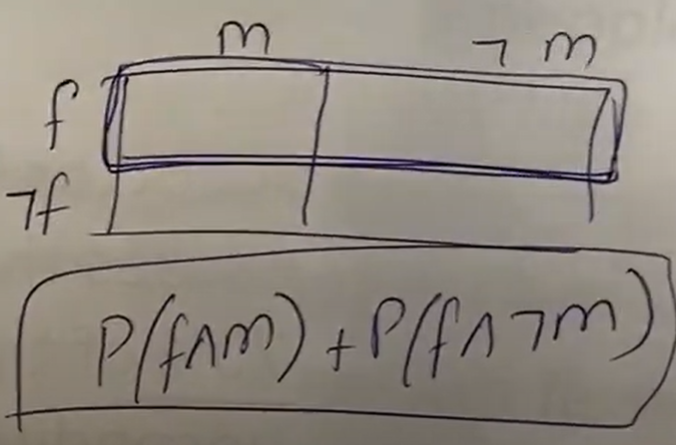

### Bayes Rule

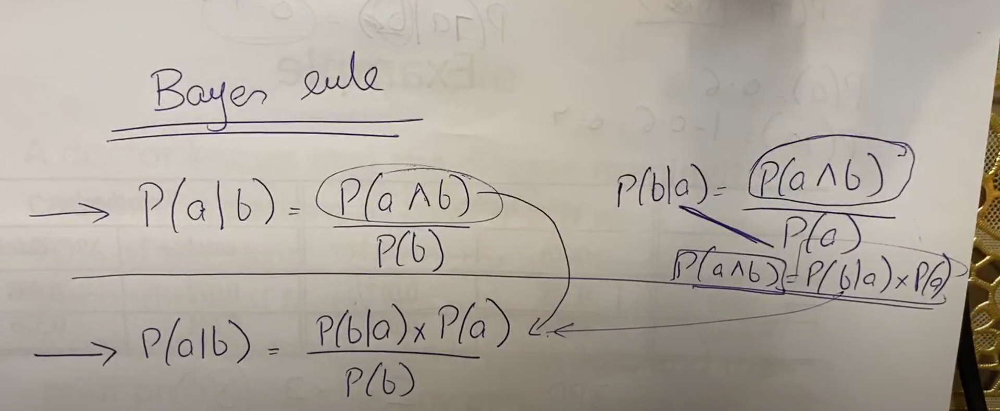








<br>
<br>
<br>

<hr style="height:8px; background-color:	#00FFFF; border:none; margin-top:30px; margin-bottom:30px;">

<br>
<br>
<br>

---

## **Marginalization**

---

## **Bayesian Networks**

---

## **Markov Assumption**


---












<br>
<br>
<br>

<hr style="height:8px; background-color:	#00FFFF; border:none; margin-top:30px; margin-bottom:30px;">

<br>
<br>
<br>

---

# **Optimization**

---

## **Local Search**

---

choosing the best option from a set of options. the first algorithm for this will be local search:

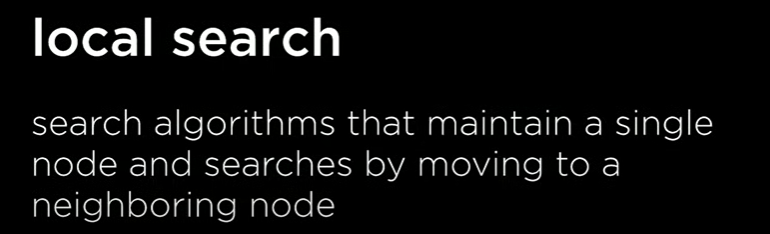

we use local search when all we care about is, what is the solution. what the goal looks like is the heart of the algo.

eg:

consider we have 4 houses and we have to place 2 hospitals, we have to place those hospitals with some sort of objective. the objective here is to minimize distance from the houses to the hospital.

for calculating the distance, we can of course use manhattan distance.

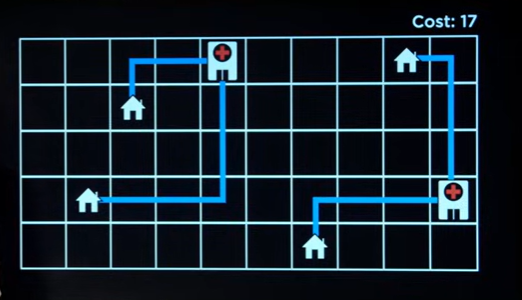

we can think of problems like these using a state space landscape, where each bar would represent a particular state, the height of the bars in the state space landscape could be a function of that state, here, you can say its the cost of the state.

we either wanna maximize the value of this function, as in the longest vertical bar (global maximum). the function we try to maximize, that function is called the objective function.

we can also reverse this and try to find the global minimum, when finding minimum, the function we use is called the cost function.

in local search, we just move to the neighbors, so a state that is close to the current state but not too far.

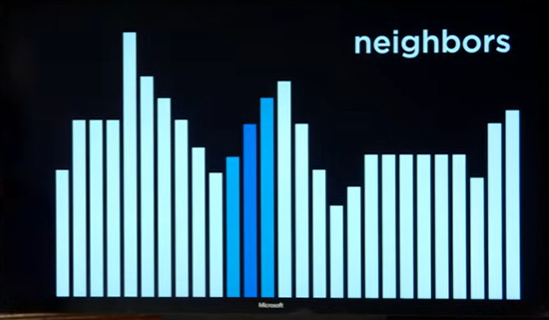

### **Hill Climbing**

the simplest algorithm to implement local search is hill climbing. it considers the neighbors of the current state. so consider the bar to your left and right and pick the max neighbor and so on. the goal is to get to a point where both neighbors (left and right) are less then the current node (meaning the max out of the 3 is the current node)

for minimum, we could simply do the opposite:

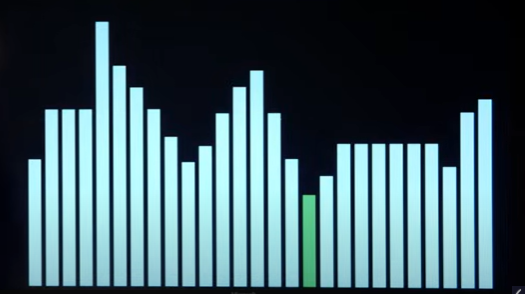

pseudocode for hill climbing:

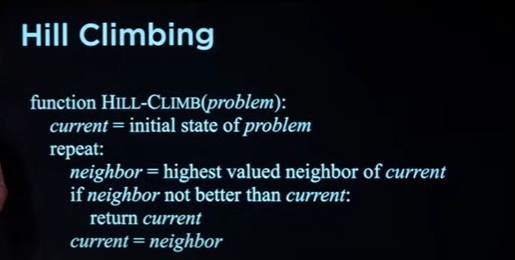

eg:

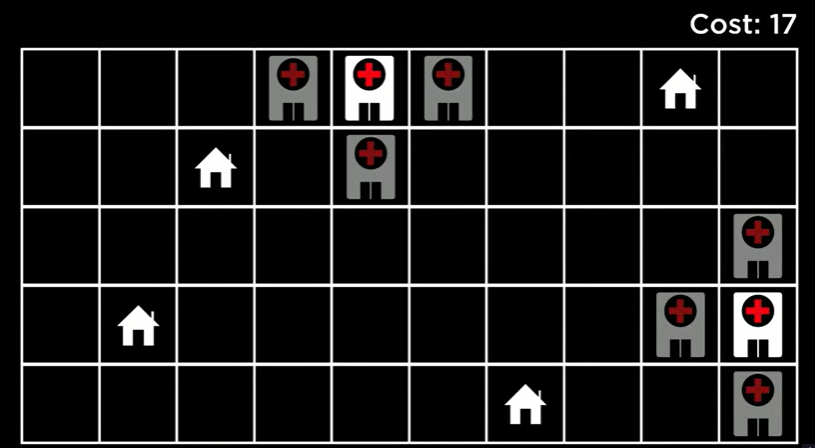

so above, we have 3 neighbors for each hospital. we take the best neighbor and make that our current

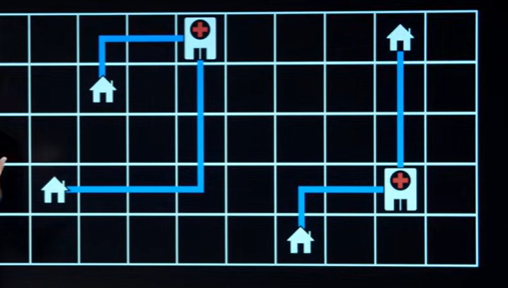

and we just keep doing this:

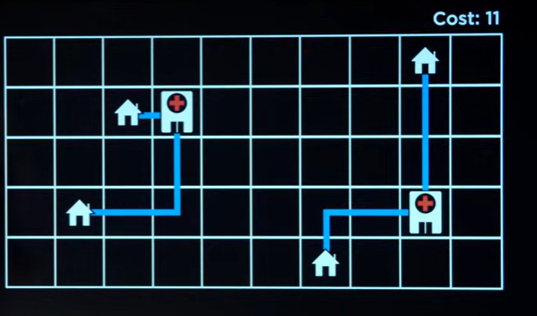

we just keep asking the question 'can we do better by making small, incremental changes'

but, hill climbing isn't optimal, it doesn't always find the optimal solution, we can get stuck at local maxima and never reach the global maxima.

another issue could be flat local max

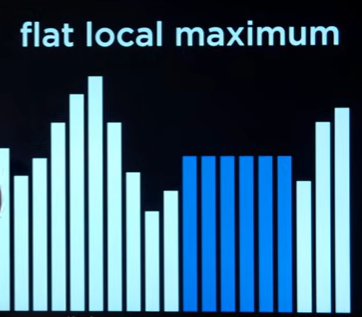

there are also shoulders:

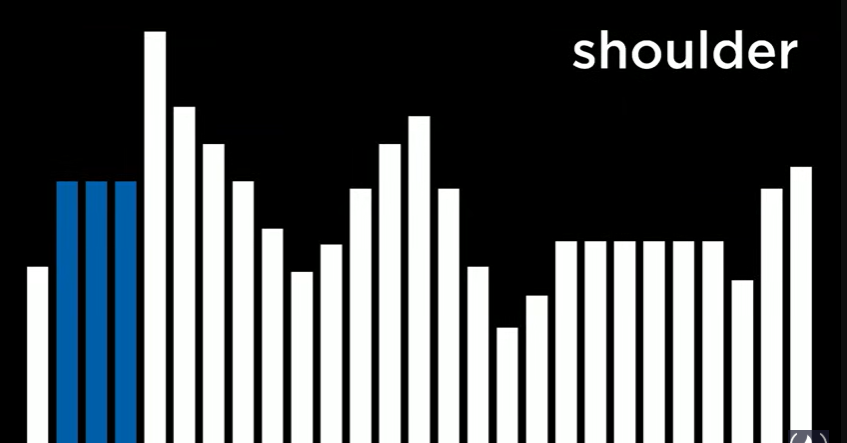

now, we have variants of hill climb algo to solve these issues, the variant we covered is called steepest-ascent hill climb

here are the variants of hill climb:

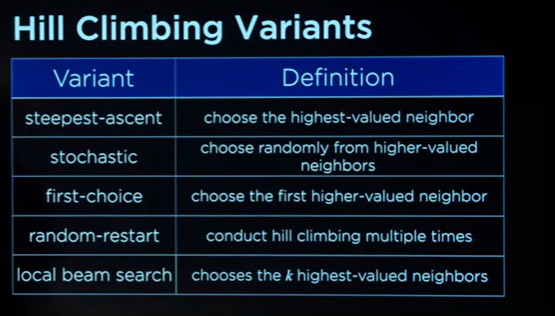

---

### **Simulated Annealing**

the real issue with all these hill climbing algos is that they never make a move that is worse then the current. sometimes, we gotta make a worse move to find the optimal move, and hill climb can't do that.

we use a diff algo called simulated annealing. we will start making more random moves (worse moves) initially and then decrease random moves slowly.

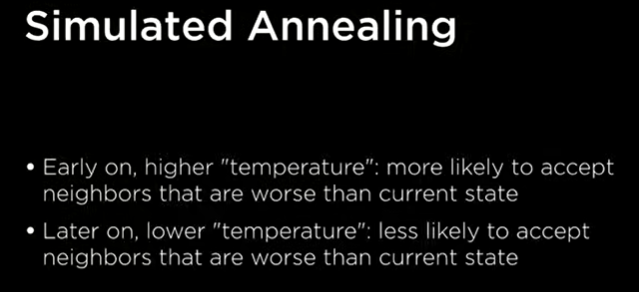

here is what the pseudo code looks like:

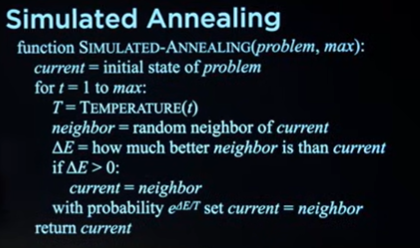

sometimes, we move to the worst neighbors, this will dislodge us when we get stuck.

these algorithms have lots of applications.

lets take traveling salesman problem, it is NP-Complete, so we use some kind of estimations for it.

there are many ways to consider neighbors in TSP.

so local search is about the goal.


## **Linear Programming Algorithms**

now we have another type of algorithm, linear programming algorithms.

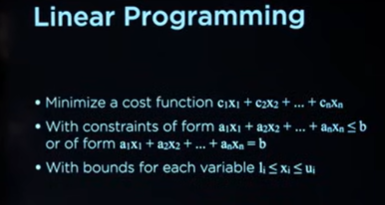

if you can formulate a problem in these terms, you can use a number of algorithms on it.

eg:

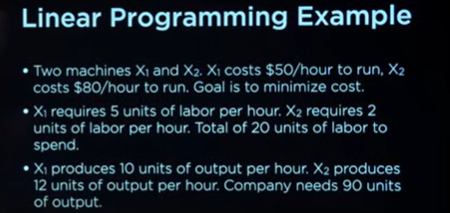

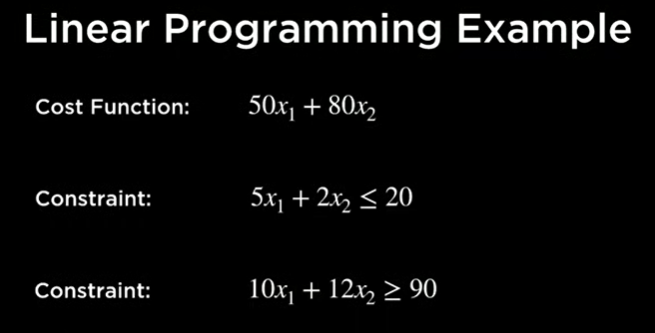

you can multiply by negative 1 to flip the greater then sign:

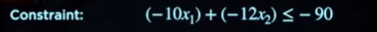

two algorithms for linear programs is:

### simplex and interior points algorithms

python has a library called scipy for scientific calculations.

constraint satisfaction problems:

there is some constraint that you would want to satisfy.

the nodes are the classes, the edge is a constraint

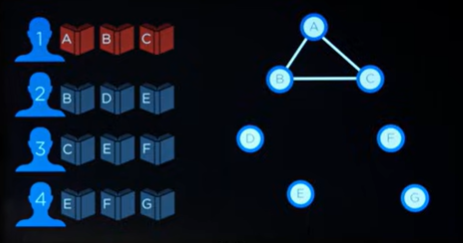

class A and B and C cannot have an exam at the same time. we combine the nodes according to the constraints. here, it is an inequality constraint

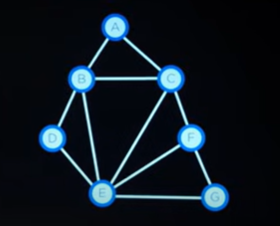

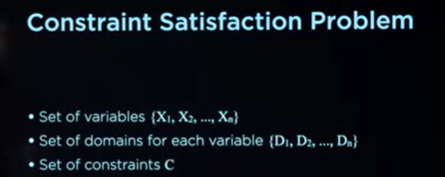

sudoku is a popular example of constraint satisfaction problem.

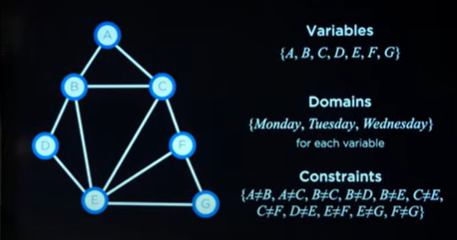

there are types of constraints too:

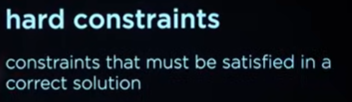

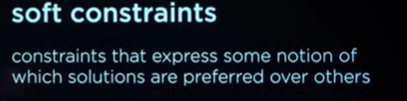

we will deal with hard constraints mostly:

we also have unary and binary constraint

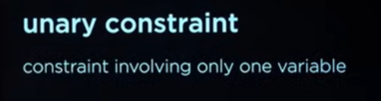

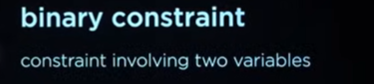

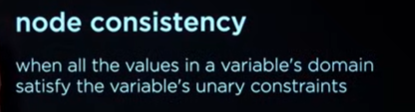

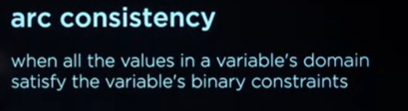

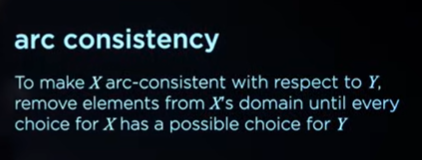

for every choice we make in A's domain, there should be a consistent choice in B's domain.

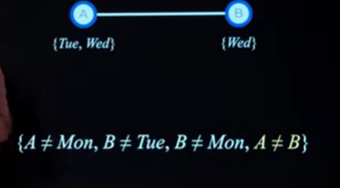

there is no arc consistency above since if A chooses the Wed value from its domain, then there is no consistent value for B to choose

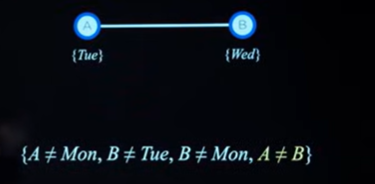

that is arc consistent

CSP = constraint satisfaction problem

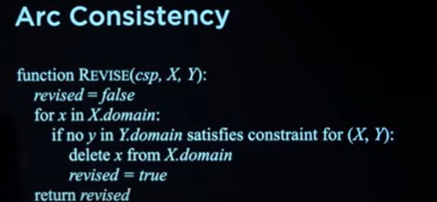

AC-3 is an algorithm that enforces arc consistency across the entire problem:

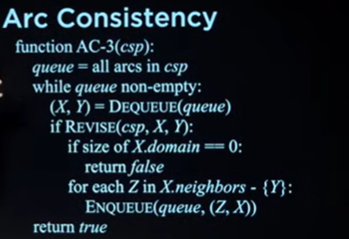

we can formulate a CSP as a search problem:

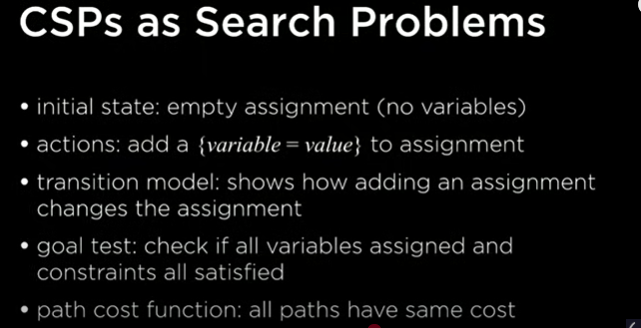

for CSPs, we will use backtracking search:

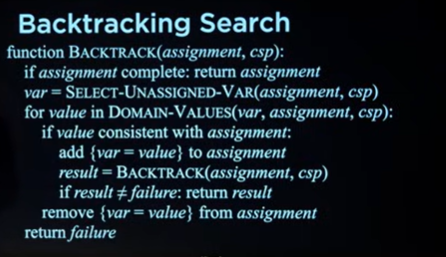

we can solve that graph using backtracking, that schedule graph:

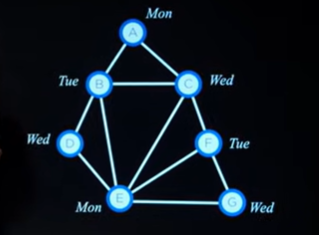

python has libraries for CSPs too, one of them is called constraints

we can use inference to reduce backtracking

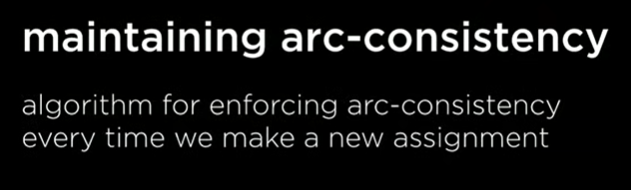

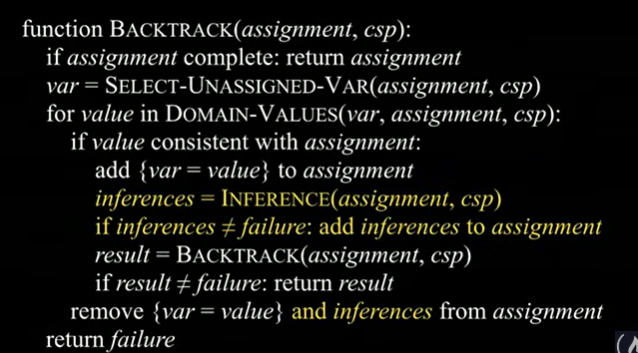

we can use heuristics to further optimize, like, we can select the variable with the smaller domain and complete that first, that heuristic is called MRV, as in minimum remaining values.

another heuristic is degree heuristic, as in, choose the variable with the highest degrees

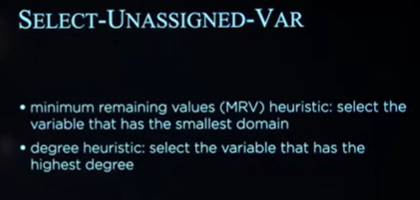

we can also apply heuristics on picking which domain value:

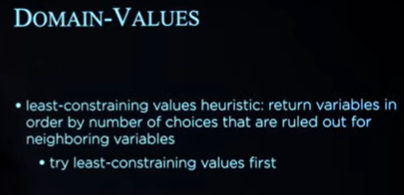



<br>
<br>
<br>

<hr style="height:8px; background-color:	#00FFFF; border:none; margin-top:30px; margin-bottom:30px;">

<br>
<br>
<br>



## **CSP Revision**

https://youtu.be/yYQIG9iVvVQ?si=r8IuASWLscV96yNz

You can solve problems much faster using CSP. 

### CSP has 3 things
- variables (jinka solution nikalna hai)
- domain (options kya kya hain)
- constraints 


### how to write constraints

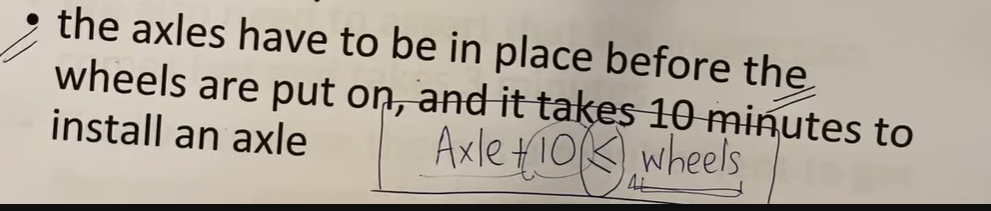

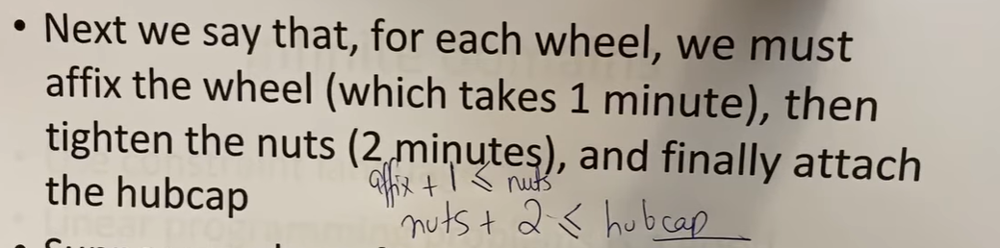

### types of constraints:

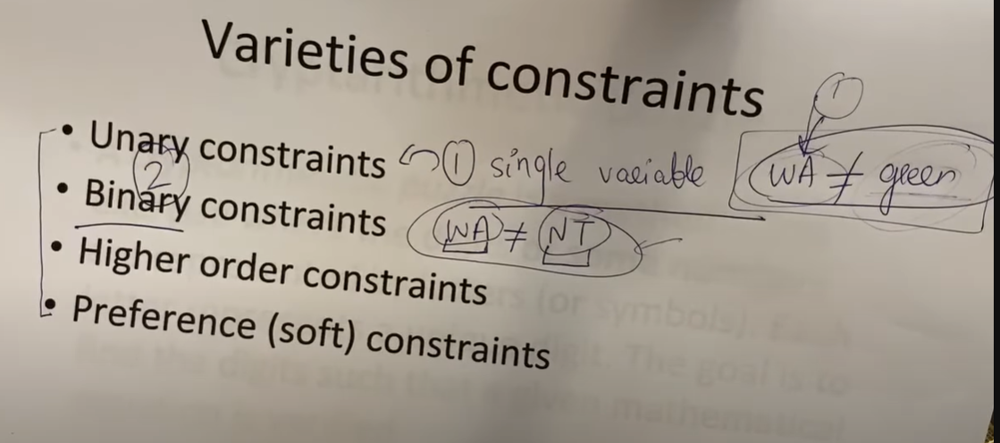

- preference constraints is just a preference, like in map coloring, a node prefers a specific color above the rest. if we gets that color then its great, if it doesn't get it, then it still works.
- higher order constraints have lots of variables in play, an example is cryptarithmetic
  - 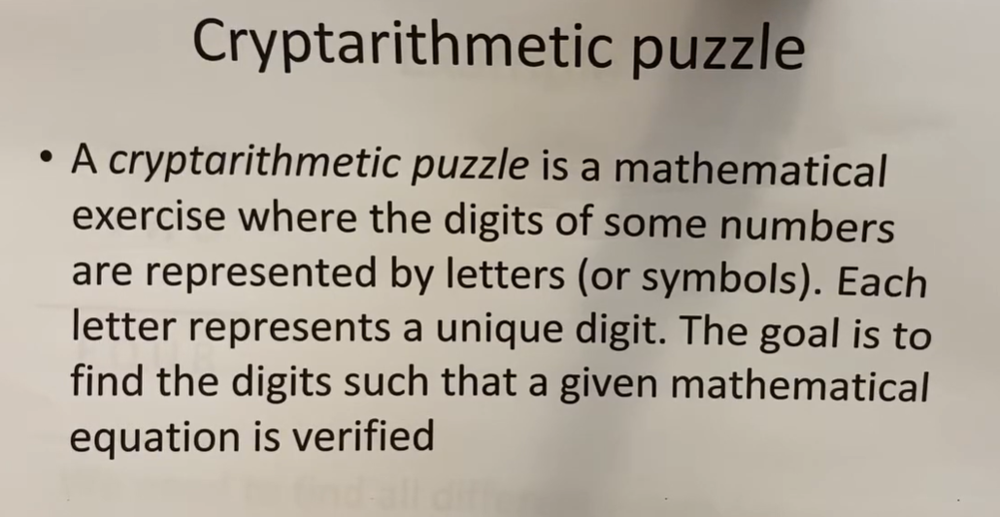

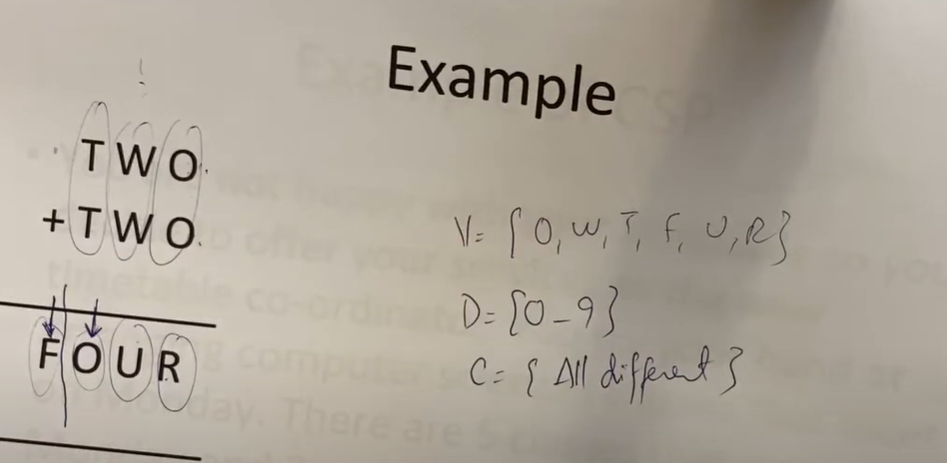

- we can draw some conclusions from the above image:
  - O is used thrice so it has the same value in all 3 places (something from 0 to 9 since thats our domain)
  - F is at the end so we can assume that when we add T into T, we get something greater then 9. and since the max in our domain is 9, the biggest sum we can possibly get would be 9+9=18 so the carry would be 1. hence, we can conclude that F=1 since we get F by adding T+T.
  - we can also derive a simple formula from the provided info. we get R by adding O into O. so if O = 9 then 9+9=18, we can say O + O = R + carry. but carry is only 1, so we must multiply 10 with that 1 to get the right answer.
    - 9 + 9 = 18 ; O + O = R + carry*10 = so --> 9 + 9 = 8 + (1 * 10) = 18. and this holds for everything in the question.
  - 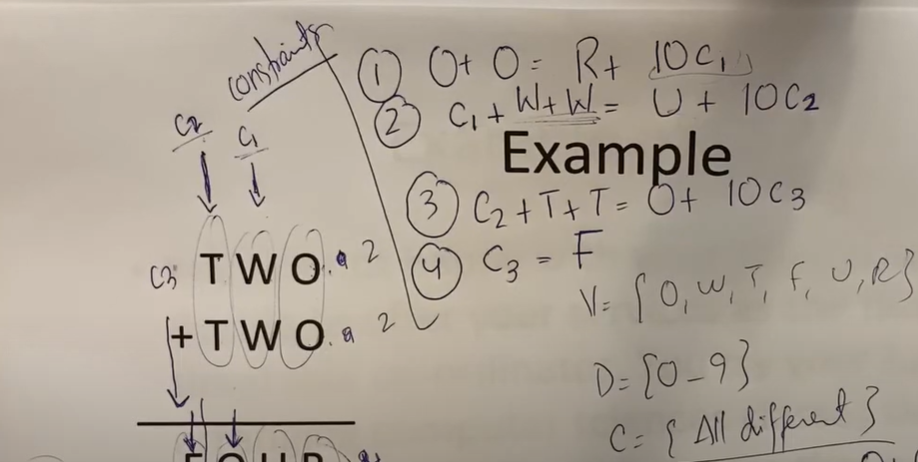
- 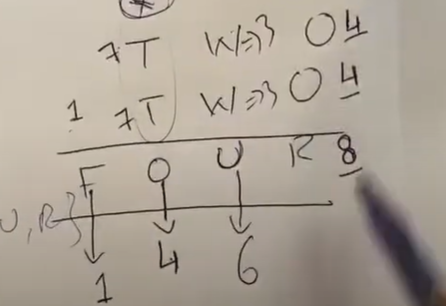
- you do have to just do trial and error on the values in cryptarithmetic


### Local Consistency

https://youtu.be/hPeh9-Zf1J8?si=ygneq0PefldZsDmn

- node consistency (unary)
- arc consistency (binary) --> AC3 algo. arc consistency is a preprocessing step, you shrink the domains before assigning values. at the start, you just enqueue all the nodes into the queue and check each and then if the domain is shrunk then you add the neighbors of that node into the queue as well
- path consistency (the node between the source and destination) --> third variable, which is connected to both a and b (a triangle)
- k consistency (k is the number of nodes here) --> if k is 1 then its node consistency, if k is 2 then its arc consistency and so on
- global consistency --> sudoku example (choose the most constrained cell and fill that first)
- bound propagation
  - the range is basically constrained. we say minimum 420 passenger, both flights combined. then, we must have minimum 35 in flight 1, and minimum 385 in flight 2, that new range happened because of our constraint of 420. this is bound propagation
  - 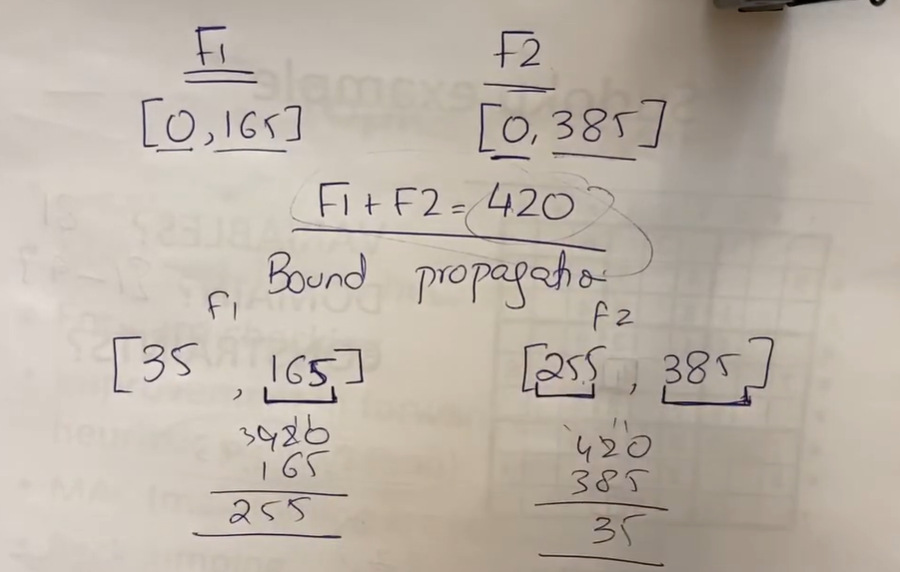




### Backtracking and Optimized versions of Backtracking

https://youtu.be/4Ei2OTPtrV4?si=Ny4licSQqsU515TZ


https://youtu.be/4UV5abWQFUU?si=LzcsxCoyoFs0Wj7d

- backtracking: you have an issue, you move back, you choose something else, you go forward, and keep going. this is very high time complexity and it takes forever.
- MRV: minimum remaining value, you go to the variable with the least amount of values in its domain and assign value to that variable first (consider the state jiske paas sab se kam values reh gayi hain)
- variable ordering is ke kis variable ko prioritize kerna hai (MRV uses variable ordering) and value ordering is that jab variable choose kerliya, then uski domain mein se kisi value ko preference deni hai ya nai.
- value ordering can also be like: pick the least constrainting values (apna faida and dusro ko kam se kam nuksaan kerro). keep the domains as big as possible. this is called the least constrainting heuristic. dusro ki domain khali nai honne deni, if khali hogayi then we can't solve
- degree heuristic: choose the variable with the highest degree (most edges connecting to it)
- we can make first decision in MRV using degree heuristic, and then use MRV
- forward checking: we check one step ahead and neighbors ki domain ko shrink kerdete hain simply. you assign values and then shrink domains, so no preprocessing steps. you can either do arc consistency, or forward checking, doing both is useless. forward check stops and backtracks if some node gets an empty domain and doesn't have a value assigned.
- we can improve forward checking using the degree and MRV approaches. like, we can pick the variable using MRV and also do forward checking
- MAC (maintaining arc consistency): you don't just add all the nodes into the queue at the start, you first assign a color and shrink domain of the neighbors accordingly (like in forward check) and then you run arc consistency algo on the neighbors of the nodes whose domains got shrunk. and keeps cascading like that. its a lot better then forward check since we find the issue before time.
- back jumping: its not that good of an approach, but its better then normal backtracking. in normal backtrack, you just backtrack to the parent and choose a different option and so on. in back jumping, we see directly kis node ki waja se issue hua hai and jump back to that instantly. we do this by maintaining another linked list with each element, its like a conflict set, it tells ke konsi value domain se nikali hai and kis wja se nikali hai. btw, issue means domain khali hona

# **Learning**

## **Supervised-Learning**

machine learning is when we don't give the computer explicit instruction on what to do, we give it data.

supervised ML: given a data set of input-output pairs. learn a function to map inputs to outputs.

### **Classification** 

classification: supervised learning task of learning a function mapping an input to a discrete category. eg: a bank note, is it forged or real? or weather, is it ganna rain or be cloudy? 
think of a function f that takes inputs like humidity and pressure, and using that, it predicts is it going to rain or be cloudy.

this function f is complex, we want to hypothesize this function so its easier to understand, so we have a function h with inputs humidity and pressure.

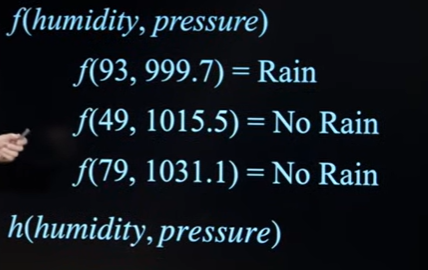

the inputs will be the axis, like pressure is y axis and humidity is x axis. now we can plot our data points on this graph. blue dots are rainy and reds are not rainy

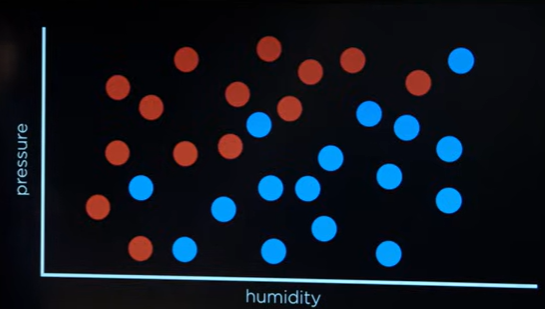

#### **KNN**

we might say that one of the datapoints is white and we want to calculate that if that white dot is rainy or not rainy. and we can simply see the datapoints close to the white dot and see if they are blue or red and based on that we can classify the white dot too. this would be nearest-neighbor classification.

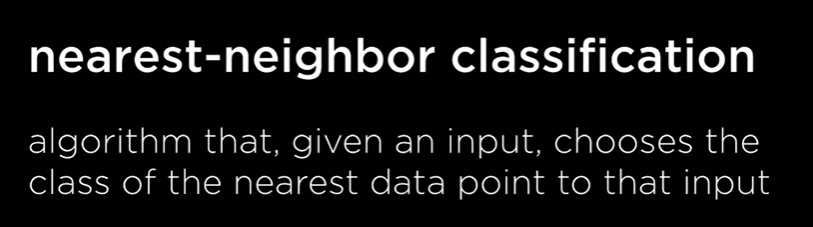

things get a bit tricky if you have the following scenario:

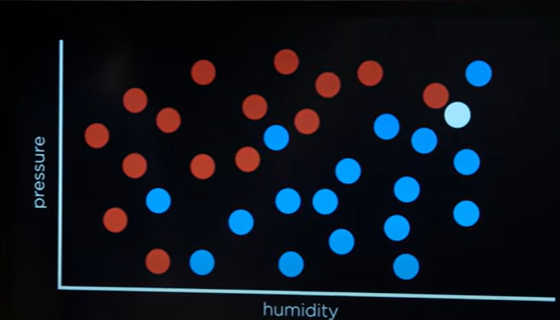

using NN, you would say its red since the closed dot is red to that white dot. but its also reasonable to say that it should be blue since its surrounded by more blue points. 
so, sometimes its better to consider multiple neighbors instead of just one, and that is called k-nearest-neighbor algorithm

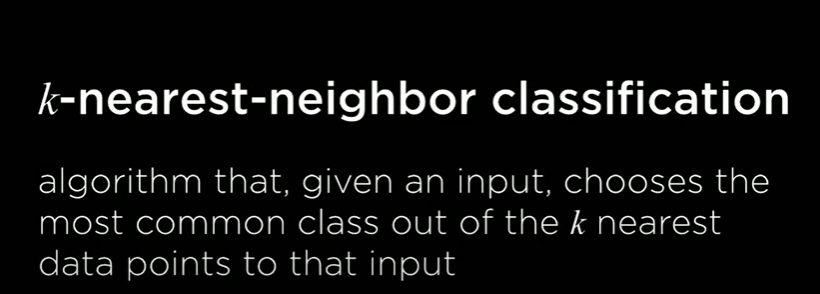


the k could be 3 or 5 or 7 and so on, it would choose the most common class out of those k neighbors. so, its like voting, the neighbors are voting.

this algo works very well for classification, but it could have a very high time complexity, the naive approach is hella slow, there are ways to prune and optimize and use better data structs to mitigate the disadvantages, but, lets consider a completely diff algo:

#### **Linear Regression**

what if we drew a line to separate the categories? this would be linear regression. 

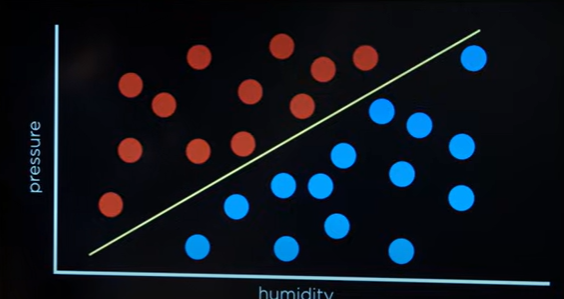

this is too idealistic, data is mostly messy, data is not linearly separable mostly:

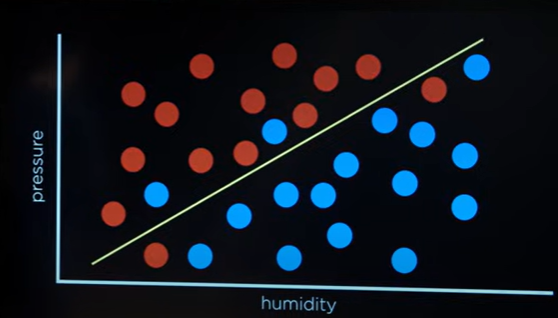

but we can still say the above line does a pretty good job

lets formalize this line thing, as in linear regression:

the boundary is going to be a linear combination, which is taking each input and multiplying it with a weight, we gotta figure that weight out ourselves:

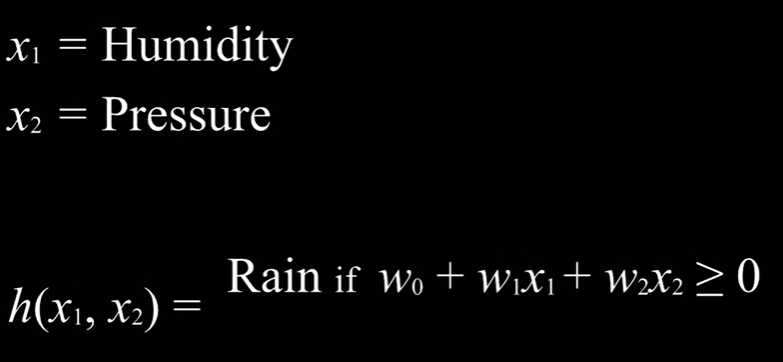

0 can be the boundary, if its greater or equal to 0 then its at one side, if less then 0 then other side.

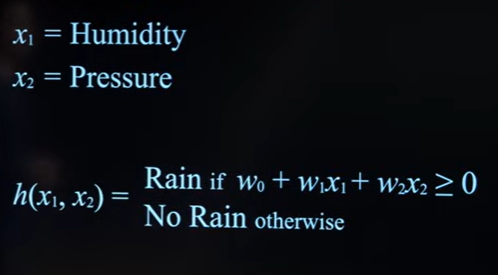

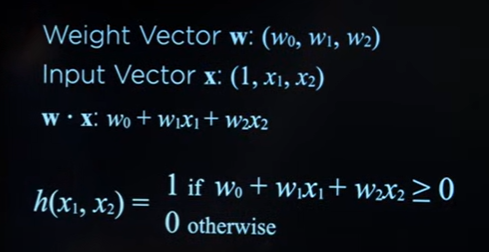

the hypothesis function would look something like this:

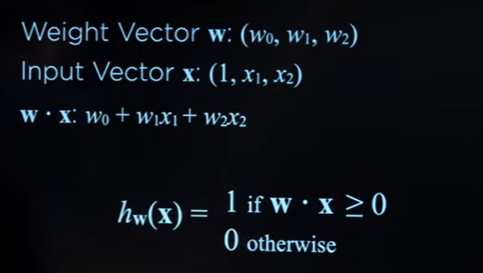

the hypothesis is parameterized by the weights. 

so the question is, how do we find the right weights?

one common methods is perceptron learning rule:

we can start from random weights, and then slowly slowly move from there and better our weights:

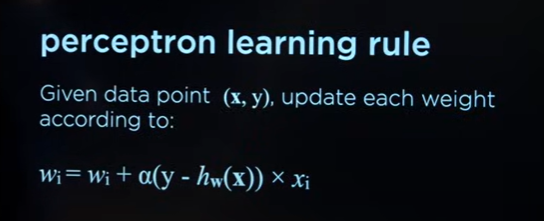

the hypothesis is the estimated value and if the actual value - the estimated value is 0 then our weights are good already.

if actual value is bigger then estimate, then we gotta increase the weights and get a bigger output. and the inverse of this is also true of course.

the alpha in the eq is called learning rate, if alpha is bigger then weights are updated by a lot and vice versa.

we can repeat this on each datapoint until we converge.

we will ultimately have a threshold function, which would look like this graphically:

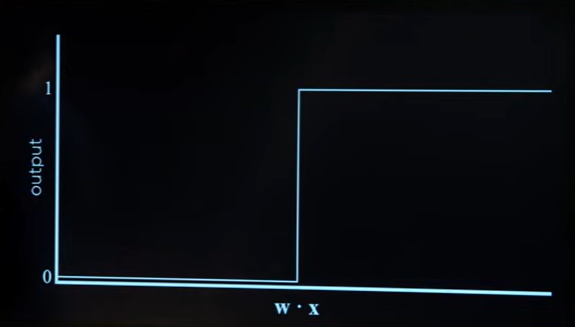

the issue with this hard threshold function is that we end up with only 2 results, there is no in-between. what if we wanna know how strong a prediction is? like, one datapoint could be a lot more likely to be rainy then another datapoint, the line strategy doesn't let us measure strength. we can be more confident about one datapoint while being less confident about another datapoint. our threshold function is a hard threshold, it doesn't allow for this strength feature.


we can try logistic regression instead of linear regression, so we have a soft threshold instead of a hard threshold:

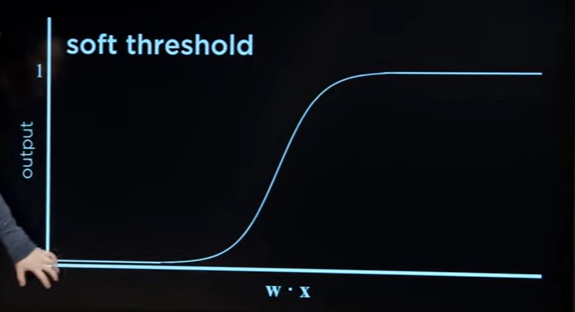

so these are 2 approaches, one is the NN thing and the other is about drawing a line. the third approach is Support Vector Machine:


#### **Support Vector Machine (SVM)**

SVM says that there are a lot of lines that we can draw to separate the categories:

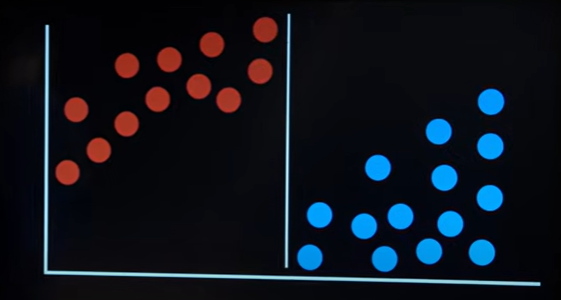

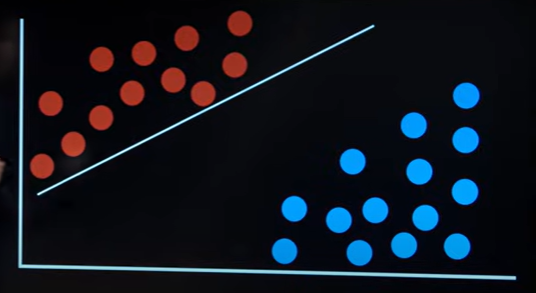

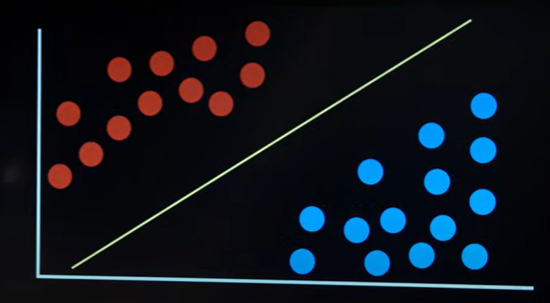

the issue is about generalization, these lines don't generalize well, as in, it won't classify datapoints that are not in the dataset.

the third line, that is perfectly distant from the red and blue dots is the most reasonable option here, and that line is what the SVM helps us find, its helps us find the maximum margin separator

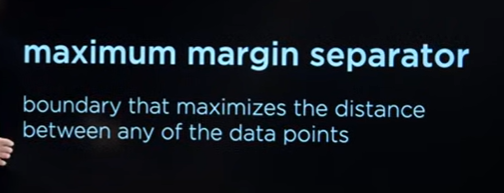

SVM does this by finding the support vectors. SVM works well when data is not linearly separable:

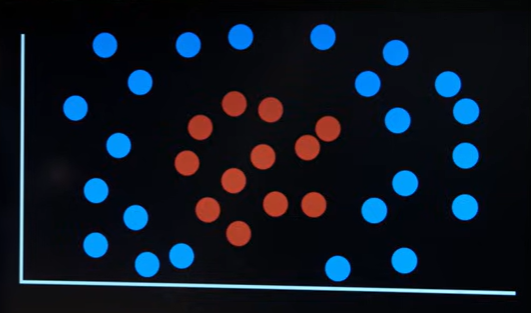

there will be a lot of loss no matter what line you draw. we must find a better decision boundary. SVM can operate in higher dimensions and find a better boundary. 

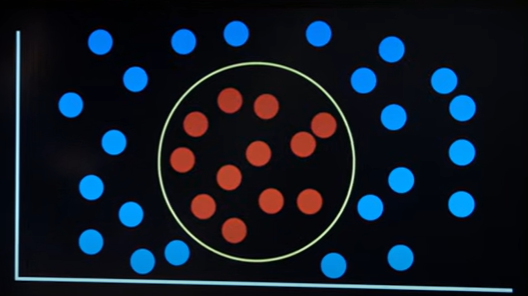

ok, now we have seen 3 approaches, one isn't better then the other, remember that.


---

### **Regression**

classification is not the only supervised learning problem. another type is regression:

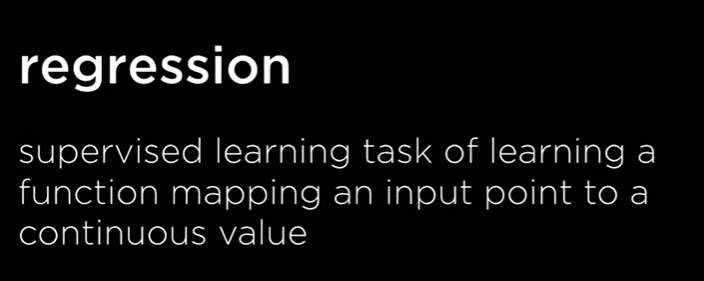

its continuous, not discrete. 

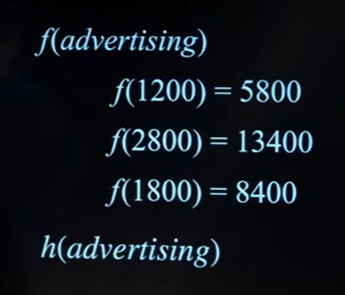

again, we can use linear regression here as well. just draw a line to find the relationship:

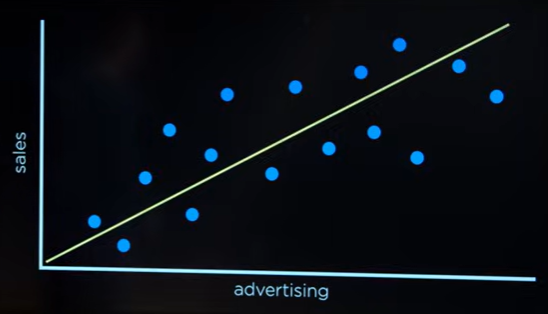


well, how do we evaluate these approaches? well, you can think of this as optimization.

the evaluation is done using a loss function, we gotta minimize the loss function

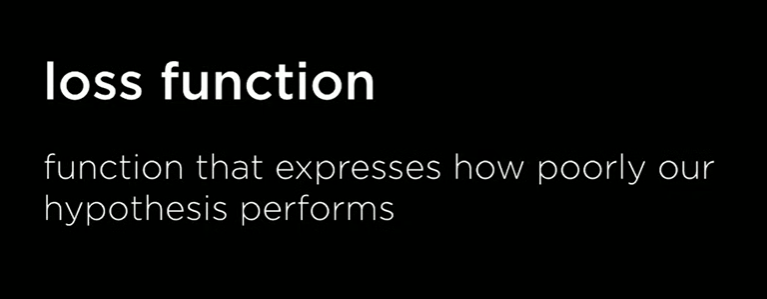

there are popular loss functions, a classification problem could use a 0-1 loss function:

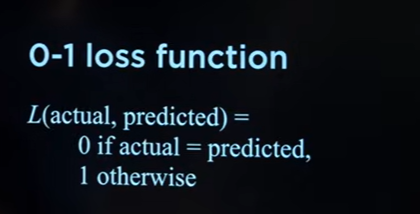

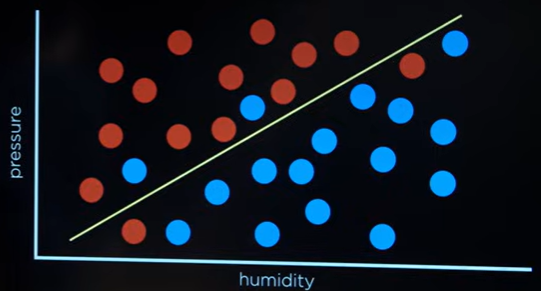

we can assign each point a value, 1 for not predicted right and 0 for predicted right

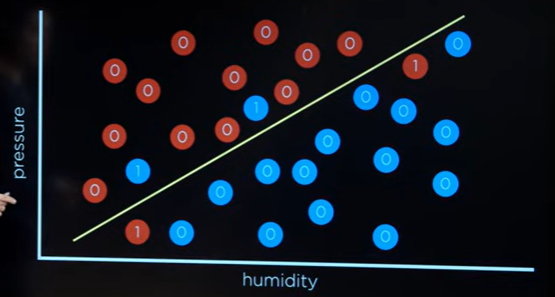

so we have a total loss of 4. 

for regression, the loss function would be different, we would use L1 loss function:

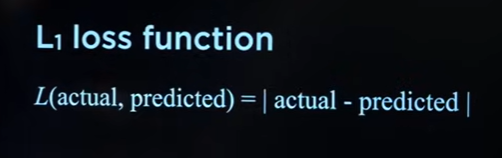

we see what is the diff between actual and predicted value and we sum that up across all the data points.

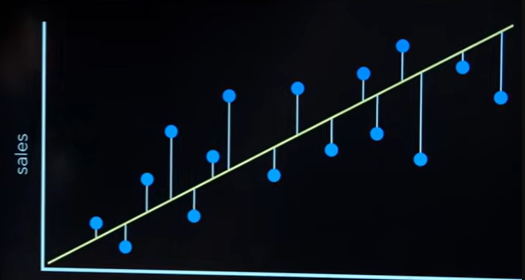

there are many other loss functions as well, like L2 loss, it uses the square of actual - predicted, basically penalizing and being a lot more harsh:

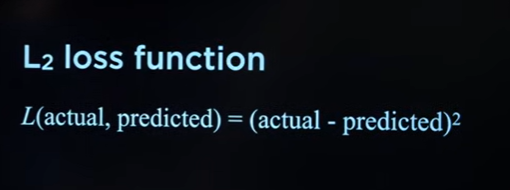


---

### **overfitting**

a big problem that you will encounter using any of these loss function is overfitting:

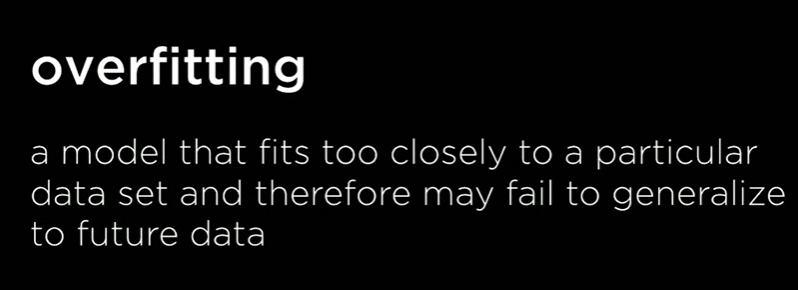

its when your model works too well on the dataset and then it doesn't generalize well as a result. so you can do super well and minimize the loss perfectly, but then your model won't generalize well.

this is what overfitting looks like

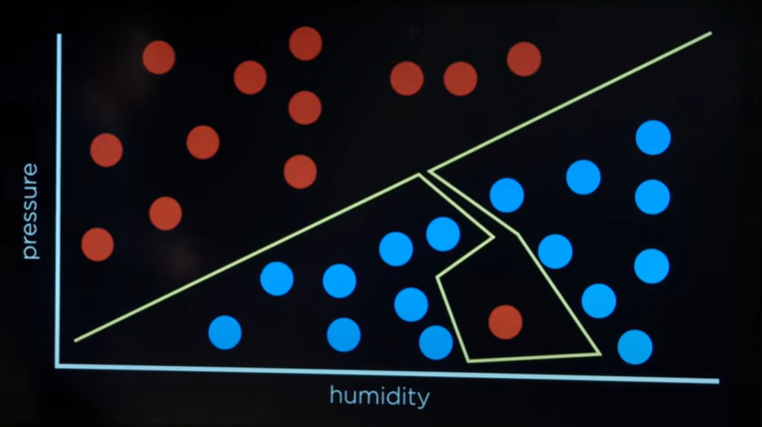

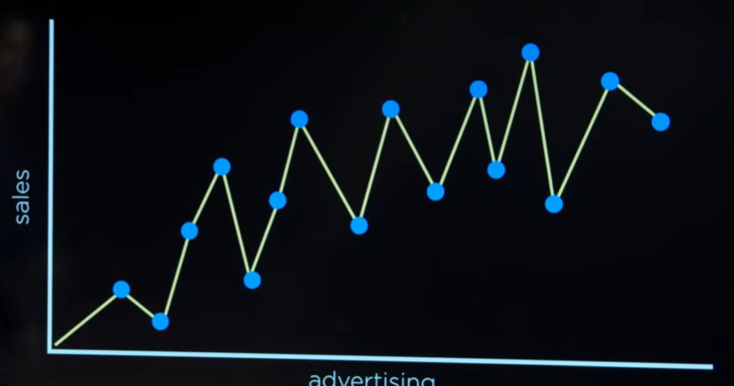

and overfitting can happen both in regression problems and classification problems.

#### **Overfitting solutions (Regression and holdout cross validation)**

you can say the cost function == the loss function but we should add something else to the loss function to prevent overfitting.

that thing we add is called complexity, we gotta have some kind of balance between the loss and complexity:

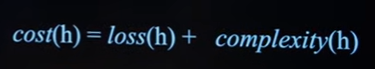

to get this balance we multiply lambda to complexity, lambda being big means more penalizing. 

and you gotta experiment etc to find the right values. this whole thing is called regularization:

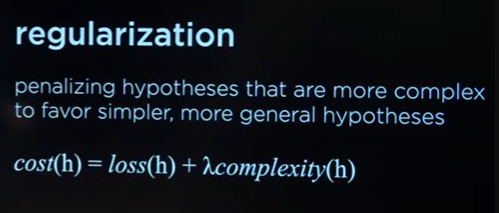


so this whole lambda and complexity approach, where we do this occam's razor thing (that's a fancy word that means when faced with competing solutions, the simplest one is probably right) where we select less complex hypothesis basically. lambda is what determines how much we don't want complexity, if lambda is big then we penalize the complex hypothesis a lot.


#### **Holdout cross validation**

another way to make sure we don't overfit is to check if we are able to generalize or not, we experiment a lot. we train on some of the data, and test on the rest of the data:

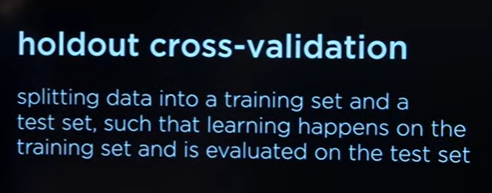

the learning happens on the training set, and then we see how well it does on the testing set. 
one issue with holdout cross validation is that if we do 50-50, then a lot of the data is simply not being used for training, to fix this, we have:

#### **k-fold cross validation**

we divide the data into k different sets, say 10, and we train on say 9 of them, and test on only 1, and then again we train on the first 8 and the last, and test on set number 9 or something. we get like 10 different results and then we can take the avg of the 10.

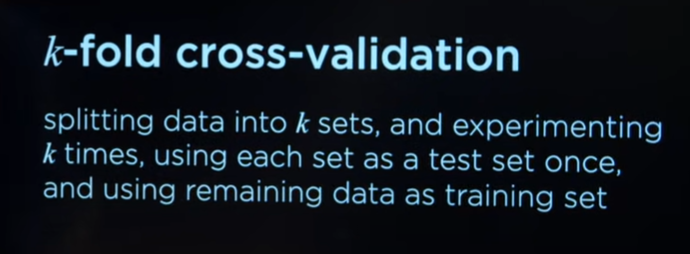


we could implement this stuff in python using scikit-learn library (he was using the UC-irvine dataset, the counterfeit cash one).


ML is a lot about trying multiple diff algos for the same tasks and seeing which works best and so on.


anyways, the story doesn't end at supervised learning. we also have:



---


## **Reinforcement Learning**

its about learning from experience

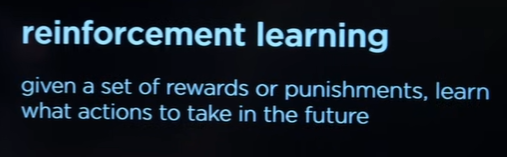

it will make some actions, it will get some reward or punishment based on that action.

there will be some environment where the agent is, the agent would be in some state, and it would do some action. after the action, 2 things will happen, it will be in a new state and also, it would get feedback. 

we will formulate that as a:

### Markov decision process

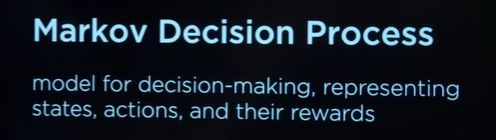

its a model we can use for decision making. a markov chain had a bunch of stages where each transitioned into another:
it was like a literal chain:

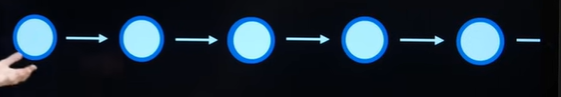

but now, lets say its not a linear chain, let say that at each stage, the agent can make multiple decisions:

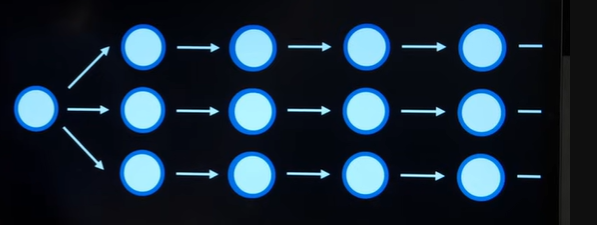

so we basically have choices now, one more thing we will do is that we will associate a reward with state:

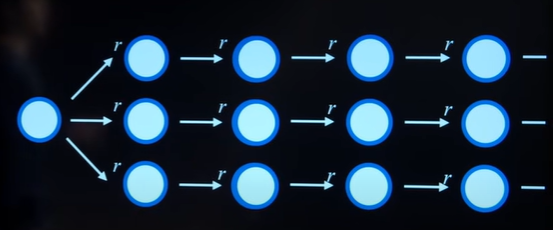

r being positive means reward, r being negative means punishment

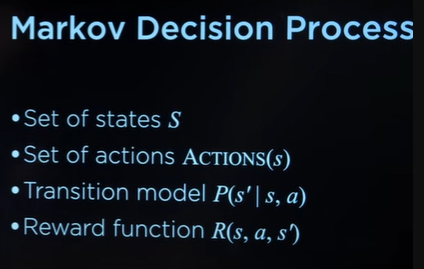

lets create a simple grid, we have an agent and its trying to find its way to the goal, and there are also some red states which give punishment. it would just traverse the grid and learn.

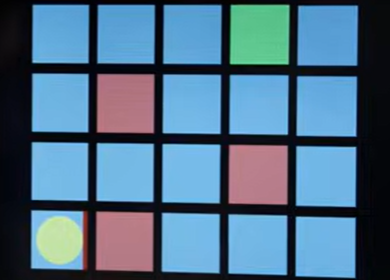


we will only look at 1 reinforcement learning model:

### **Q-Learning**

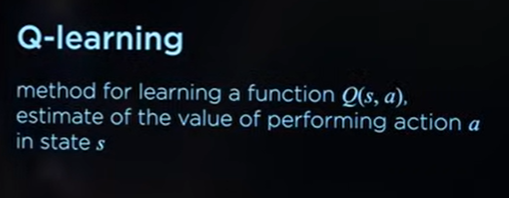

its about learning a function that takes input s and a, where s is state and a is action, its about learning the Q of s and a for all the states. Q function will estimate the reward on a state based on an action. initially the Q(s,a) = 0 and then i will start taking actions and i will start estimating the value of Q(s,a). but we don't just consider the current reward, we also consider the future reward we might get.

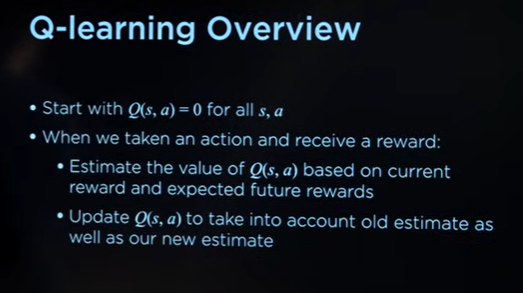

here is the approach we will take:

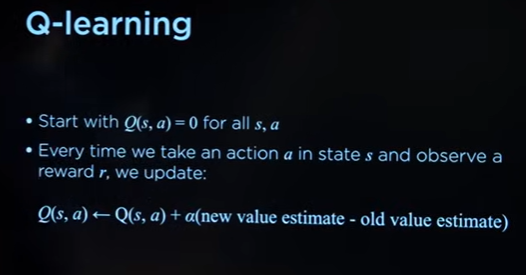

the alpha controls how relevant the new info is, 0 would mea we completely disregard the new value.

go to this timestamp:
8:44:00

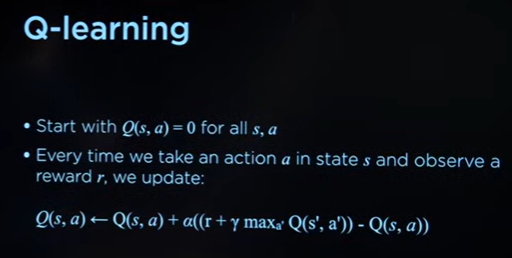

once we have an estimate, we can implement a greedy-decison making policy, where we just pick the action that has the highest value

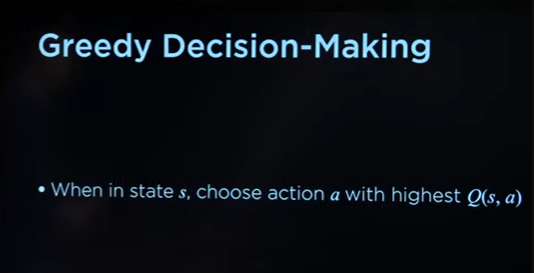

but that has a downside, if the agent doesn't explore more, then it might never find a better answer, it will never know it exists. it might leave lots of paths untravelled and therefore, might leave out many possibilities that might ultimately yield better results.

so in AI, we have this thing where we have **EXPLORATION VS EXPLOITATION** where exploitation would be using knowledge that the AI already has.

so, in order to kinda address this, we have:


#### **$\epsilon-greedy$ approach**

how often do we wanna make a random move is epsilon. 

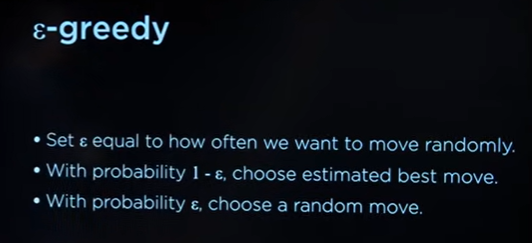

so sometimes we choose best move, and sometimes we choose random moves. eventually, we go again and again and reduce the value of epsilon


one common application of reinforcement learning is games. we just make the AI play a whole bunch

we can think of a game called Nim. its a 2 player game where players take turns removing objects, you can remove as many objects you want, from 1 row at a time only. minimum amount of objects that you can remove is 1.

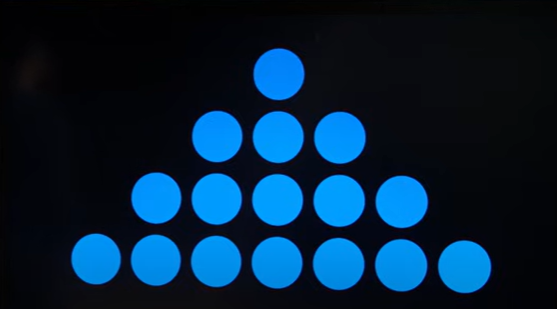

whoever takes the last object, loses the game

but Nim is super easy, it has limited states. what about chess or a game that is even more complex? well, we use function approximation

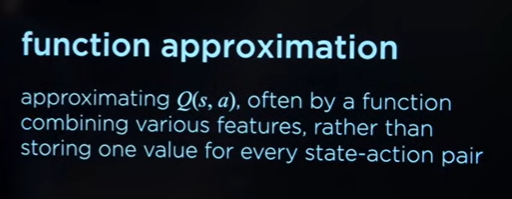





the third type of machine learning is called:

## **Unsupervised-Learning**

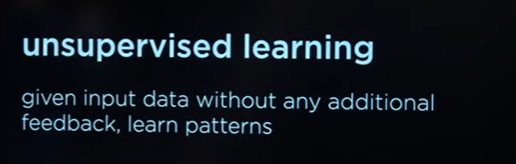

one task in unsupervised learning is:

### **Clustering**

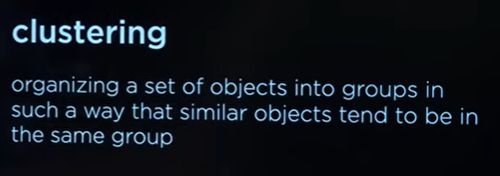

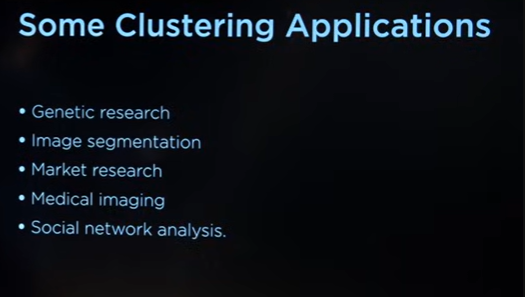


one algorithm for clustering is:

### K-means clustering

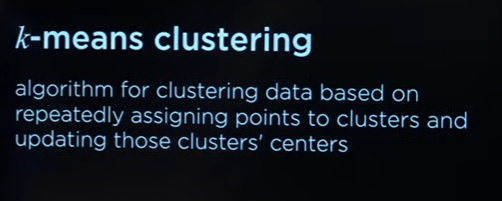

- choose centroids (initially random)
- assign points to a centroid to make clusters

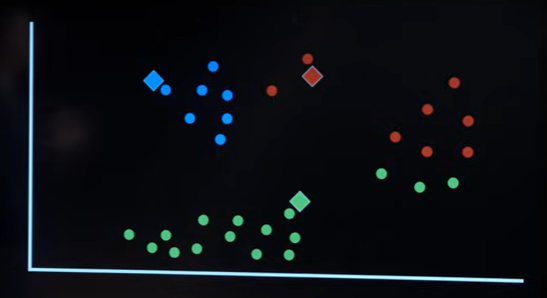

- this is an iterative process. after the first iteration, we choose new centroids.
- we re-center, we take them to the avg of that whole cluster. so the centroids essentially move to the center of their respective cluster
- now, we repeat the entire process again

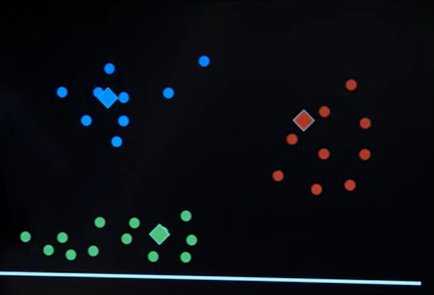

- and we just keep repeating, until, there is an iteration, where no point changes its cluster, so like, we kinda reach equilibrium. this is when the algo is over






<br>
<br>
<br>

<hr style="height:8px; background-color:	#00FFFF; border:none; margin-top:30px; margin-bottom:30px;">

<br>
<br>
<br>


# **Neural Networks**


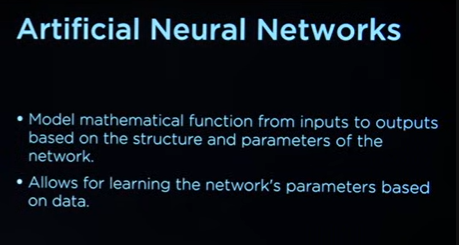

we have artificial units (artificial neurons) and we connect one to another.

again, we are going to do prediction. last time we used a hypothesis function with weights and stuff. and we had that threshold function, the step function. this is called an activation function in neural networks. we also looked at that logistic function (sigmoid) for threshold. that is also just another activation function

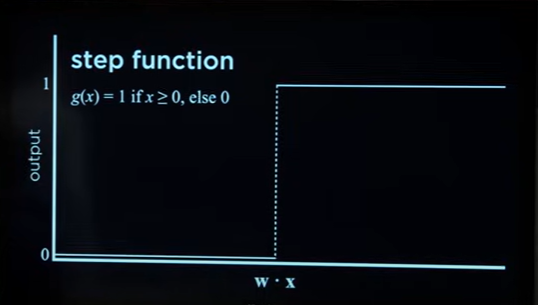

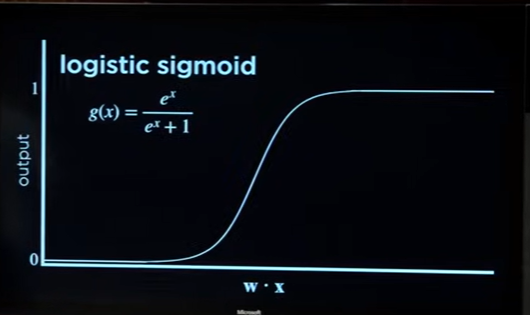

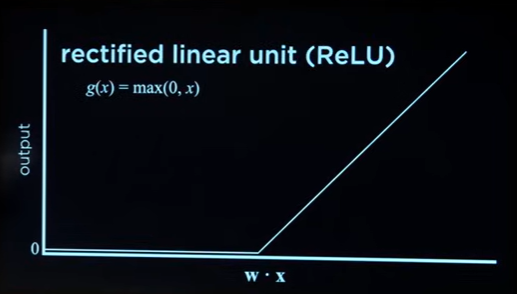

these activation functions are applied to our results.

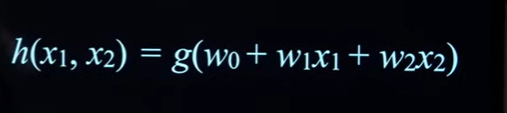

and this simple hypothesis function, could be a very simple neural network

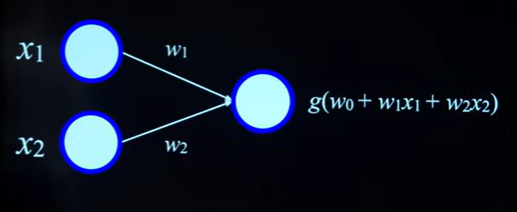

one simple function we looked at back in propositional logic was the OR function.

we use the step function as our activation function

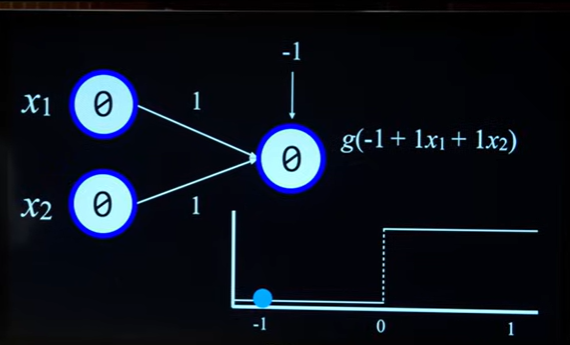

that -1 that is incoming on the third node is called bias (or weight_0) btw.

so, in the above image, our inputs were 0 and 0 and the weights were 1 and 1 and the bias was -1. and we ended up with an answer of -1 which is before 0 in the step function so it should be false and indeed, in an OR operation, if input is 0 and 0 then it returns false

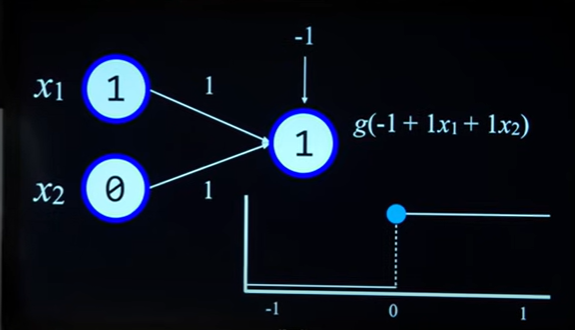

now input is 1 and 0 with the same weights and bias and the output we get is 0, which is at the threshold and so we should get an answer of true and that is again, what the OR operator would return

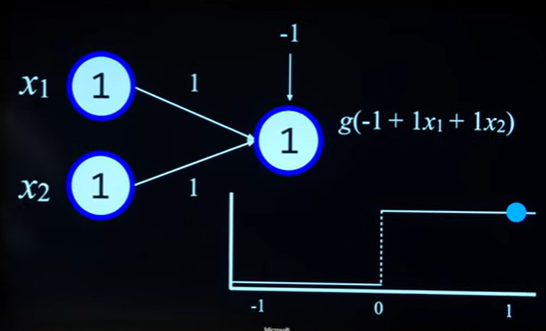

so this above neural network models the OR function basically

if we use -2 as our bias, it would turn into an AND operator neural network.

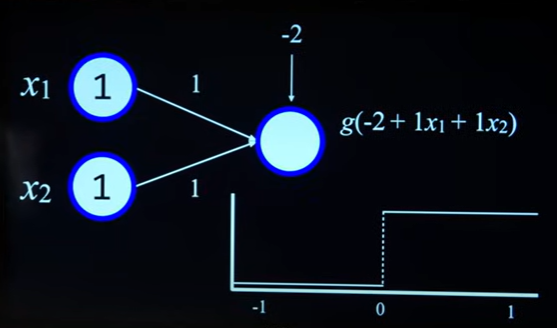



we can just add more units for more inputs in neural networks:

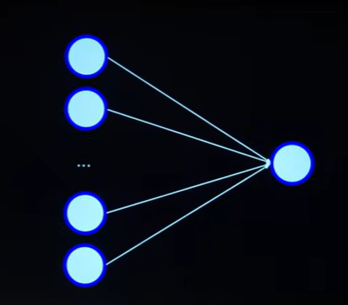

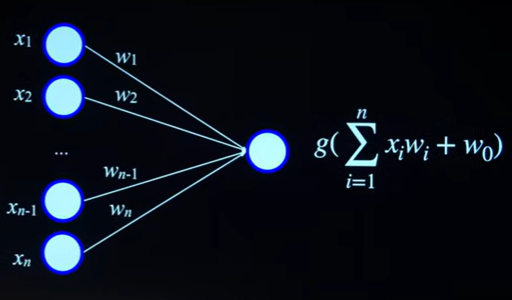


but, how do we train these neural networks?

we want the computer to somehow calculate the weights by itself:

## **Gradient descent**

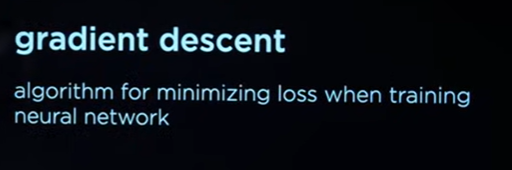

loss refers to how bad our hypothesis function is, as we have discussed previously. this loss function, is just a mathematical function:

and in calculus, when you have a mathematical function, you can easily find the gradient of that function. gradient is like the slope, the direction of the function. what is the direction of the loss? so, in which direction should we be moving?

here is the idea:

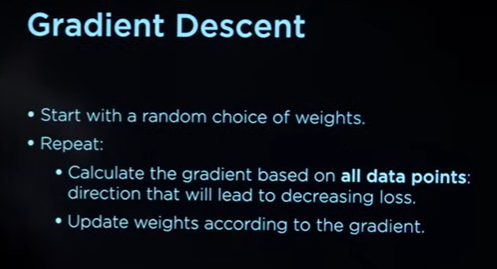

whenever you have an algorithm, one question to always ask is "what is the most expensive part of this algo", and for gradient descent, its that "all data points", that we have to calc the gradient based on all data points.

so, how do we make this a bit faster? well, we have diff types of GD:

### **Stochastic GD**

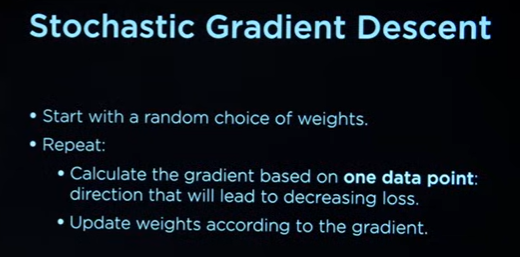

we just pick a random point in all the data points, and we use the gradient of that one point in one iteration, choosing random data points in each iteration and moving towards the gradient of that point 

now, this is obv going to give a less accurate result, but it will be much faster.

there is also a middle ground:

### **Mini-batch GD**

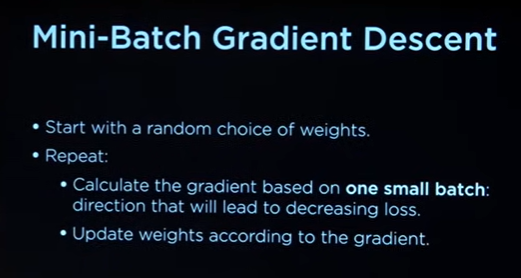

pretty self-explanatory

what if, we have more then one output? well, you can also do that in a neural network

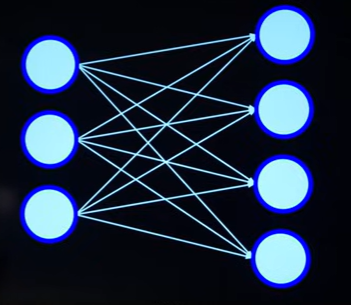

eg:
in weather prediction, we might wanna predict the weather into multiple categories, or something like predicting the probability of each category

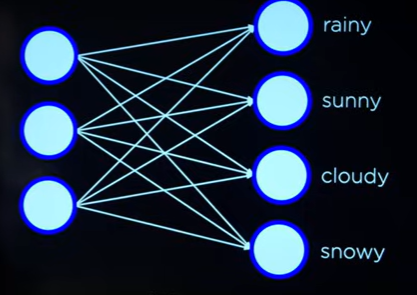

again, we have lots of weights, and we also have our activation function. but after all those calculations:

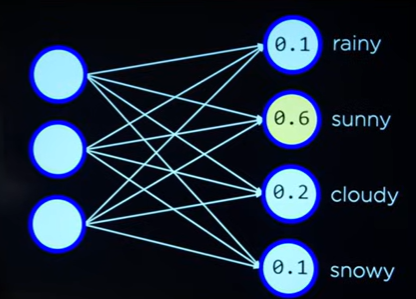

so the weather is most likely to be sunny.


we could apply the same sort of idea on reinforcement learning. each variable could represent a state and the outputs would be the actions. and we could find out which actions are better:

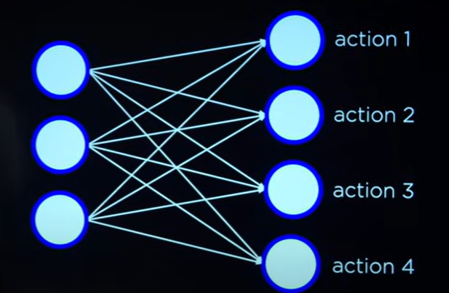

anything we could frame as a mathematical function --> you could make a neural network of.

you can think of this multiple output thing as like, multiple diff neural networks. you are just training multiple neural networks

## **Limitation of Perceptron**

what are the limitations of these approaches?

we can only work with things, that are linearly separable. it can't deal with situations like:

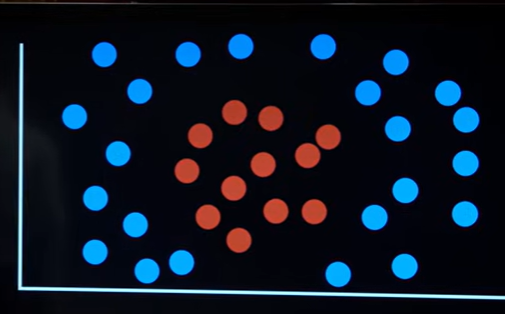

so, this is the limitation of a perceptron, that it is only capable of learning linearly separable decision boundary.

so, this won't generalize well to real world data.


so how do we solve this? well, we use:

## **Multilayer neural networks**

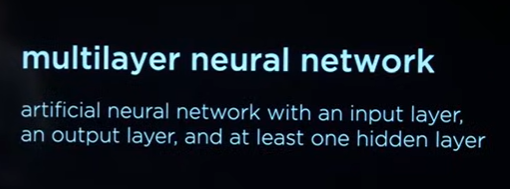

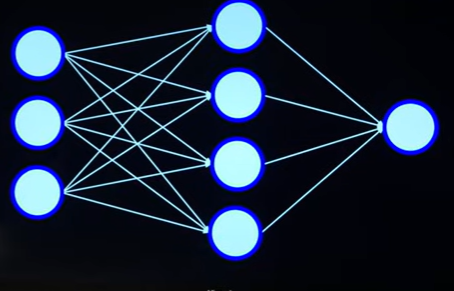

and you can choose the nodes in the hidden layer, or the number of hidden layers as well.

layering things like this lets us model more complex things.

so, how do we train a network with hidden layers? we are only given data for the input and output layers. but, if we know the loss of the output, we can kinda backpropagate and find the error in the weights and kinda move to the hidden layer

#### **backpropagation**

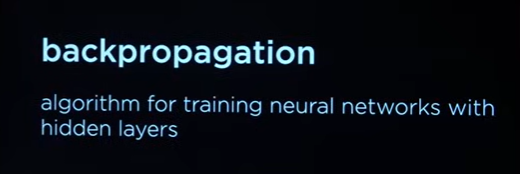


this is the idea:

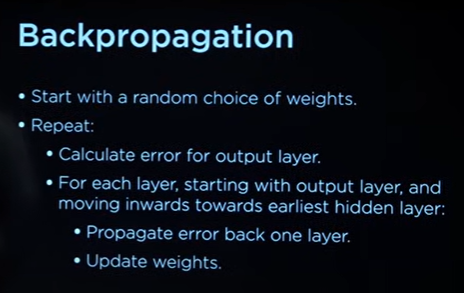


so we can have more and more layers in our network, ultimately making a deep neural network

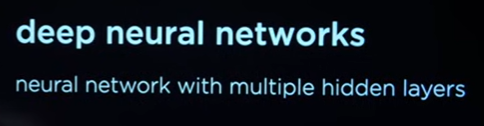

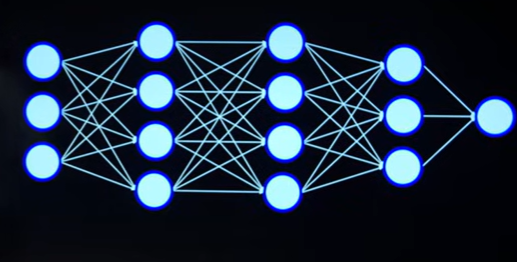


as we make our models more complex, we always run into the risk of overfitting

#### **addressing overfitting by using dropout**

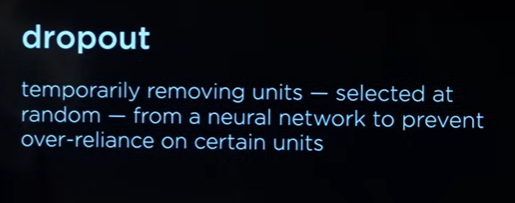

we will randomly dropout some nodes, so we don't overly rely on a specific node.


### **Tensorflow**

a library created by google for neural networks is called tensorflow. 
we can go to **playground.tensorflow.org** to understand things better

https://playground.tensorflow.org/#activation=tanh&batchSize=10&dataset=circle&regDataset=reg-plane&learningRate=0.03&regularizationRate=0&noise=0&networkShape=4,2&seed=0.64553&showTestData=false&discretize=false&percTrainData=50&x=true&y=true&xTimesY=false&xSquared=false&ySquared=false&cosX=false&sinX=false&cosY=false&sinY=false&collectStats=false&problem=classification&initZero=false&hideText=false


keras is an api, a set of functions to manipulate neural networks inside of tensorfow (other DL libraries also use keras)

a dense layer is simply a layer that is fully connected to the previous layer.

more units means you can predict more complex stuff, but remember that more units means it will be more computationally expensive and it might overfit. 

after setting up an input, hidden, and output layer (the hidden and output layers will have activation functions associated with them, and you will also specify the number of units/neurons in the layers), tensorflow also lets you choose an optimizer, which are algorithms that find the optimal weights, there are many optimizers. one more thing you have to choose is the loss function, again, there are many diff loss functions. and lastly, you have to choose a metric for evaluation.

you also gotta specify epochs, which is the number of times you go through each data point, so if epoch is 10, it will go through the entire dataset 10 times.


## **Computer Vision**

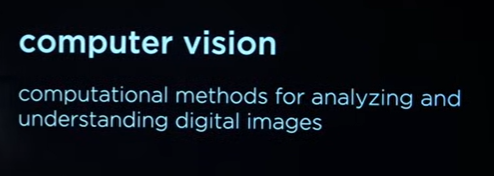

an image is a grid of pixels:

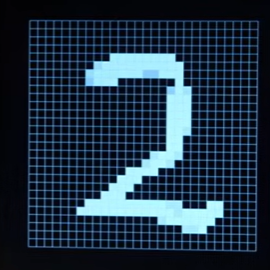

you have the whole 1 0-255 for grayscale and then 3 0-255 (rgb) for colored images

now, you could just make a super massive neural network where a unit could represent a single pixel and so on:

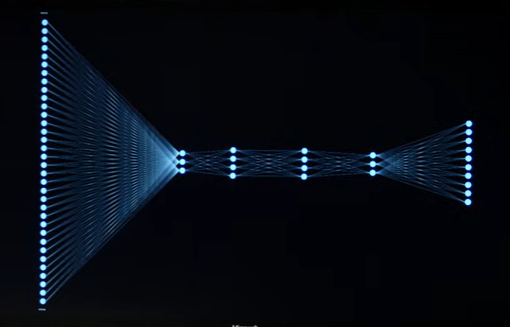

but we analyze pictures more deeply, we look at particular features, like curves or shapes. we have neural networks that deal a lot better with images. but we gotta go over some concepts first:

### **image convolution**

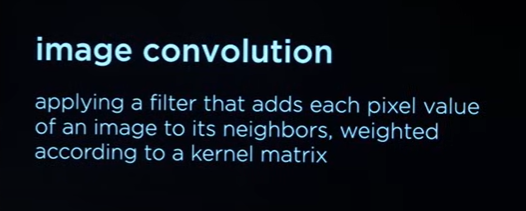

its about filtering the image, we also consider the neighbors of the pixel. we create a filter, say a 3by3 filer for a 4by4 image, and we just multiply that filter with the image:


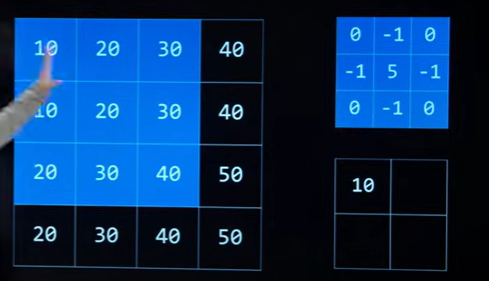

we slide the filter (filter is also called kernel):

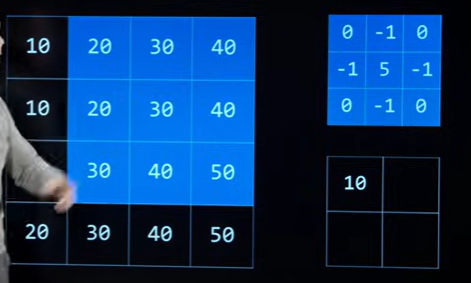

then slide the filter again:

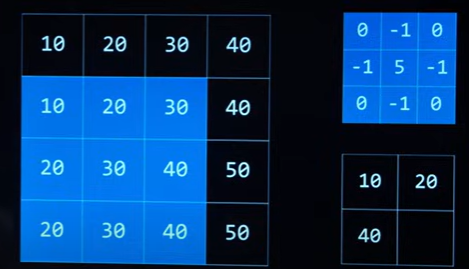

and then again

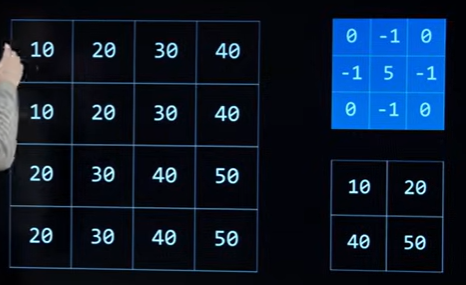

and now, we have obtained a feature map, like, a filtered version of the original image basically.

a famous kernel is:

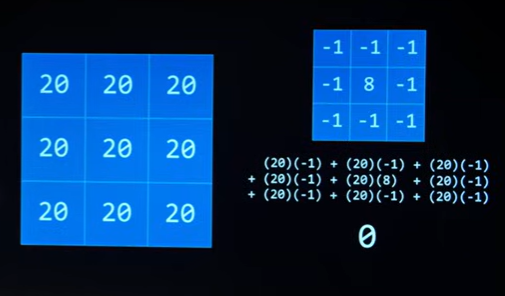

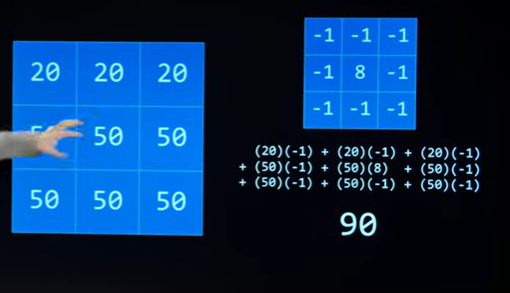

this above kernel can be used for detecting edges.

python has an image library called PIL btw.


these images are still pretty damn big, we still gotta care about every little pixel, we need to change that. and we do that by: 

### **Pooling**

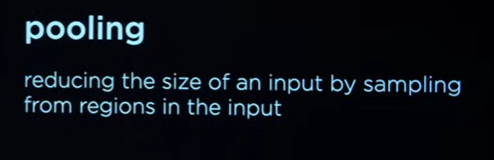


#### **max-pooling**

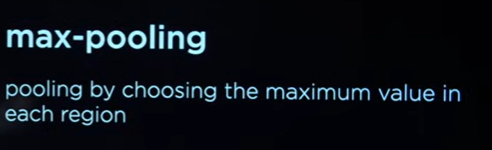

it chooses the max value in the region. we can apply a 2by2 max pool on a 4by4 image to affectively shrink it.

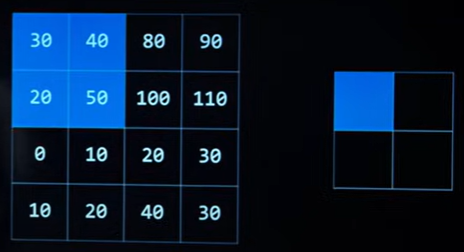

the max value in the above pool would be 50

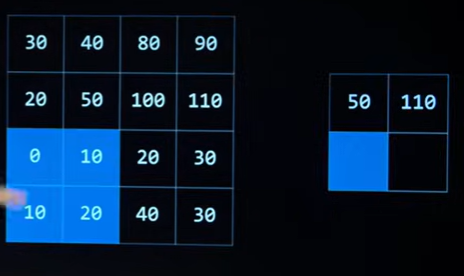

here, it would be 110. and we just do this repeatedly.

combining all of this pooling, convolutional images, and neural networks, we get:

### **Convolutional Neural Network (CNN)**

we start with an input layer, we apply a convolution step, where we apply the filter/kernel, we do this multiple times

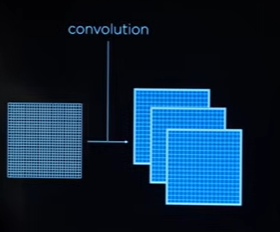

next, we do pooling on the filters since the filters are still massive. so after pooling, we have reduced dimensions on the filters. now, we can flatten these values and put them into a neural network

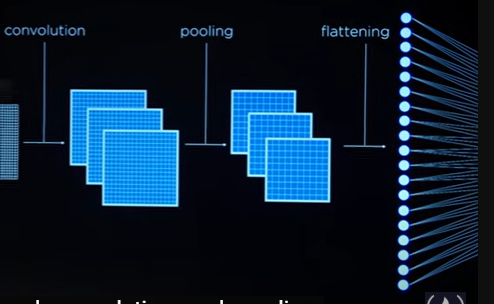

and you can use these steps multiple times, like, you can do convolution, then pooling, then do convolution again, then do pooling again, and then flatten and put it into the neural network.

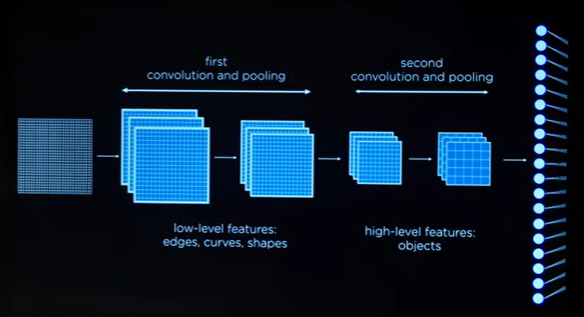



so CNN kinda just looks at an image, more like a human

we can make CNNs in tensorflow as well

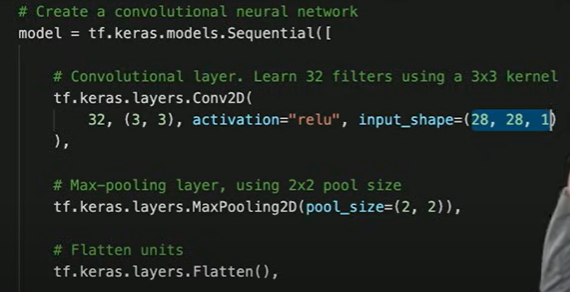

that 32 in the conv2d are the number of filters, the (3, 3) are the dimensions of each filter, we have an activation function as usual. and we also tell the dimensions of the input images, and we tell the channel value, a grayscale image has 1 channel, colored image has 3 channels

we then make a max-pooling layer, we set the dimensions of the pool here

we then have a flatten layers which just flattens it all into a single layer.

then after all that, we have our usual dense layer and dropout etc.

btw, the softmax activation function takes the output and turns it into a probability distribution

## **Feed-forward Neural Networks**

the input and output layers have fixed shapes, that is a limitation to feed forward NN

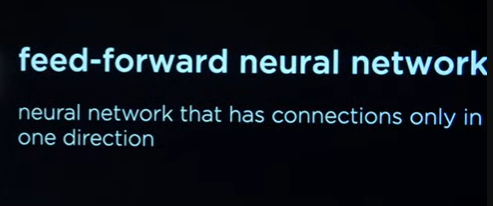

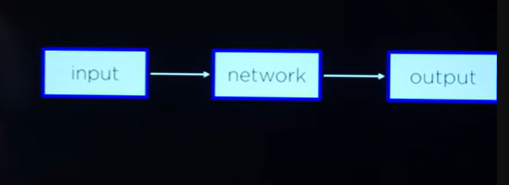

these networks just move from one layer to another and so on. but what if we have a network that doesn't just feed the output of a layer forward, what if the output is again sent to the same neuron that processed it?


## **Recurrent Neural Networks (RNN)**

its like a one to many relationship


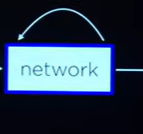

this allows the networks to save some kind of state, it lets the network store info, this really helps with sequences of data. 

an AI by MS called CaptionBot can output text if you provide it images. so there is no fixed output or input, the output could be of sequences of diff lengths. this is where we use:

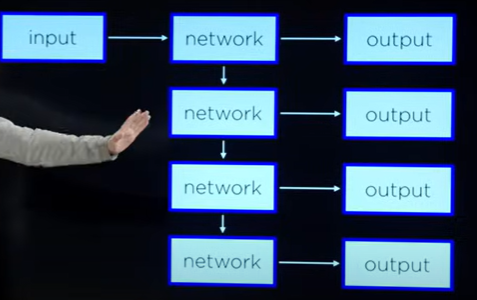

that is the one to many structure, you give only 1 input, but get a sequence of outputs. the sequence is outputted one word at a time.

so CNNs can deal with images, but what about videos? how do you give videos as inputs? well, videos are sequences basically, so RNNs could be used there. we pass the video one frame at a time and keep going.





# **continue from 10:41:00**




<br>
<br>
<br>

<hr style="height:8px; background-color:	#00FFFF; border:none; margin-top:30px; margin-bottom:30px;">

<br>
<br>
<br>